# Temperature Forecast Project using ML

## `Problem Statement:` 

Forecasts of maximum and minimum air temperatures are essential to mitigate the damage of extreme weather events such as heat waves and tropical nights. The Numerical Weather Prediction (NWP) model has been widely used for forecasting air temperature, but generally it has a systematic bias due to its coarse grid resolution and lack of parametrizations. This study used random forest (RF), support vector regression (SVR), artificial neural network (ANN) and a multi-model ensemble (MME) to correct the Local Data Assimilation and Prediction System (LDAPS; a local NWP model over Korea) model outputs of next-day maximum and minimum air temperatures in Seoul, South Korea.

## `Data Set Information:`

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

## `Attribute Information:`

`1. station` - used weather station number: 1 to 25

`2. Date` - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')

`3. Present_Tmax` - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6

`4. Present_Tmin` - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9

`5. LDAPS_RHmin` - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5

`6. LDAPS_RHmax` - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100

`7. LDAPS_Tmax_lapse` - LDAPS model forecast of next-day maximum air temperature applied lapse rate 
(Â°C): 17.6 to 38.5

`8. LDAPS_Tmin_lapse` - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6

`9. LDAPS_WS` - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9

`10. LDAPS_LH` - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4

`11. LDAPS_CC1` - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97

`12. LDAPS_CC2` - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97

`13. LDAPS_CC3` - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98

`14. LDAPS_CC4 `- LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97

`15. LDAPS_PPT1` - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7

`16. LDAPS_PPT2` - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6

`17. LDAPS_PPT3` - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8

`18. LDAPS_PPT4` - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7

`19. lat` - Latitude (Â°): 37.456 to 37.645

`20. lon` - Longitude (Â°): 126.826 to 127.135

`21. DEM` - Elevation (m): 12.4 to 212.3

`22. Slope` - Slope (Â°): 0.1 to 5.2

`23. Solar radiation` - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9

`24. Next_Tmax` - The next-day maximum air temperature (Â°C): 17.4 to 38.9

`25. Next_Tmin` - The next-day minimum air temperature (Â°C): 11.3 to 29.8T


## Goal :

Our goal is to predict 

   #### 1. Next_Tmax: Next day maximum temperature

   #### 2. Next_Tmin: Next day  minimum temperature


## Method to be used

As temperatures are given in continuous data, we will use Ragression ML algorithms to predict the required temperatures.

In [1]:
# Importing necessary libraries
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import os
import scipy as stats
from sklearn.utils import shuffle
%matplotlib inline
warnings.filterwarnings('ignore')

# Importing Dataset

In [2]:
# Reading the csv file from dataset
df = pd.read_csv("temperature.csv")
pd.set_option("display.max_columns",None)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.000000,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000,0.000796,0.000000,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


We have imported the dataset using pd.read_csv and set the option to display all the columns present in the dataset. 

In the dataset there are two target columns
- Next_Tmax and 
- Next_Tmin


In [3]:
#Checking the data in top 5 columns of the dataset
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [4]:
# Checking the diamension of the dataset
df.shape

(7752, 25)

The dataset has 7752 rows and 25 columns.

In [5]:
# Viewing the list of columns in the dataset
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [6]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

# Observations
- All the columns in the datset are in float type data except for the date column which is in the object type data
- We need to convert the date column from object type to date time data type if it is not in integer form in the further steps

In [7]:
#Viewing the info of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


# Observations

This gives the information about the dataset which includes indexing type, column type, non-null values and memory usage. 

There are some missing values in the dataset

In [8]:
# Viewing top 5 and bottom 5 rows of each column in the dataset
df.info

<bound method DataFrame.info of       station        Date  Present_Tmax  Present_Tmin  LDAPS_RHmin  \
0         1.0  30-06-2013          28.7          21.4    58.255688   
1         2.0  30-06-2013          31.9          21.6    52.263397   
2         3.0  30-06-2013          31.6          23.3    48.690479   
3         4.0  30-06-2013          32.0          23.4    58.239788   
4         5.0  30-06-2013          31.4          21.9    56.174095   
...       ...         ...           ...           ...          ...   
7747     23.0  30-08-2017          23.3          17.1    26.741310   
7748     24.0  30-08-2017          23.3          17.7    24.040634   
7749     25.0  30-08-2017          23.2          17.4    22.933014   
7750      NaN         NaN          20.0          11.3    19.794666   
7751      NaN         NaN          37.6          29.9    98.524734   

      LDAPS_RHmax  LDAPS_Tmax_lapse  LDAPS_Tmin_lapse   LDAPS_WS    LDAPS_LH  \
0       91.116364         28.074101         23.

These are the top 5 and bottom 5 rows of each column in the dataset

In [9]:
#Checking the statistical summary of the columns in the dataset
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,0.356080,0.318404,0.299191,0.591995,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,0.258061,0.250362,0.254348,1.945768,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,0.140615,0.101388,0.081532,0.000000,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,0.312421,0.262555,0.227664,0.000000,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,0.558694,0.496703,0.499489,0.052525,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


# Observations

- The count of all the columns is not same, which shows the presence of null values in some columns


- The mean is greater than the median in the following columns which says these columns are skewed to the right
    - LDAPS_WS
    - LDAPS_LH
    - LDAPS_CC3
    - LDAPS_CC4
    - LDAPS_PPT1
    - LDAPS_PPT2
    - LDAPS_PPT3	
    - LDAPS_PPT4	
    - DEM	
    - Slope	
    
    
- The median is greater than the mean in the following columns which says these columns are skewed to the left
    - Solar radiation
    
    
- The mean and median of the following columns are similar, which says the distribution is normal and has a near bell shaped symmetrical curve
    - station
    - Present_Tmax	
    - Present_Tmin	
    - LDAPS_RHmin	
    - LDAPS_RHmax	
    - LDAPS_Tmax_lapse	
    - LDAPS_Tmin_lapse	
    - LDAPS_CC1
    - LDAPS_CC2
    - lat(latitude)
    - lon(longitude)
    - Next_Tmax	
    - Next_Tmin
    
This shows 10 of the coluns are skewed to the right and only one column is skewed to left and remaining are normally distributed

- The standard deviation is low for most of the columns suggesting less skewness present in data.

- The gap between the 3rd quantile(75%) and the max in the following columns is higher, which shows there is a chance for presence of the outliers
    - station 
    - Present_Tmax	
    - Present_Tmin	
    - LDAPS_RHmin	
    - LDAPS_RHmax	
    - LDAPS_Tmax_lapse	
    - LDAPS_Tmin_lapse	
    - LDAPS_WS	
    - LDAPS_LH
    - LDAPS_CC1	
    - LDAPS_CC2	 
    - LDAPS_CC3	
    - LDAPS_CC4	
    - LDAPS_PPT1	
    - LDAPS_PPT2	
    - LDAPS_PPT3	
    - LDAPS_PPT4
    - DEM	
    - Slope	
    - Solar radiation	
    - Next_Tmax	
    - Next_Tmin
    
    
- There is no gap between the 3rd quantile(75%) and the max in the following columns, which shows there are no outliers here
    - lat(latitude)
    - lon(longitude)

# Exploratory Data Analysis (EDA)

In [10]:
# Checking the value counts of each columns
for i in df.columns:
        print(df[i].value_counts())
        print('_'*50)

15.0    310
21.0    310
7.0     310
23.0    310
8.0     310
3.0     310
10.0    310
16.0    310
11.0    310
2.0     310
13.0    310
12.0    310
9.0     310
24.0    310
4.0     310
25.0    310
22.0    310
17.0    310
19.0    310
20.0    310
1.0     310
5.0     310
18.0    310
6.0     310
14.0    310
Name: station, dtype: int64
__________________________________________________
28-08-2015    25
29-07-2014    25
12-07-2013    25
30-07-2017    25
11-07-2016    25
              ..
23-08-2013    25
24-08-2016    25
09-07-2017    25
06-07-2016    25
11-07-2017    25
Name: Date, Length: 310, dtype: int64
__________________________________________________
31.4    112
29.4    111
29.1    108
29.7    107
30.6    105
       ... 
36.4      1
20.3      1
20.1      1
36.9      1
20.4      1
Name: Present_Tmax, Length: 167, dtype: int64
__________________________________________________
24.0    161
23.8    153
23.1    144
23.5    143
23.3    142
       ... 
29.6      1
13.5      1
14.3      1
14.2    

The above are the value counts of all the columns in the dataset

In [11]:
# Checking null values in the dataset
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

There are several missing values present in many columns. We have to fill them using appropriate imputation methods.

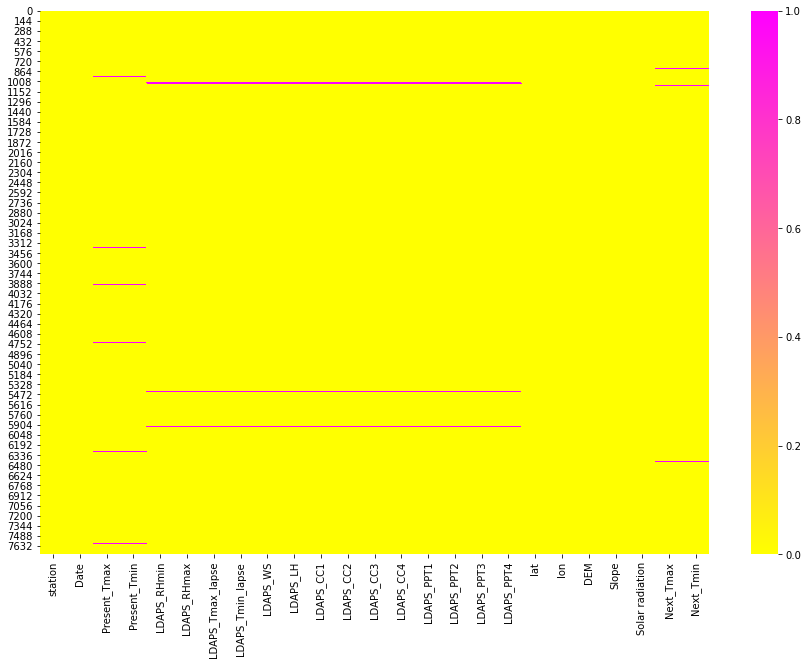

In [12]:
#Visualizing the null values using a heatmap
plt.figure(figsize=(15,10))
sns.heatmap(df.isnull(), cmap='spring_r')
plt.show()

This heatmap shows the missing values in the pink coloured lines

# Imputation - Treating null values

In [13]:
# Checking unique values in station column
df["station"].unique()

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25., nan])

From the dataset we can notice that there are 25 stations and the data is collected from each of these 25 stations every day.
Station column has missing values at the very last that is the null values in station column is present after 25, which means this data is collected from next day. So we will replace the null values in station by considering it as a next day.

In [14]:
# Filling null values in "station" column 
df['station'].iloc[7750] = 1.0
df['station'].iloc[7751] = 2.0

By observing the dataset we can infer that the Date column has null values at the very last, that means this data is also collected from next date. So we will replace the null values in Date column by next date i.e,31-08-2017.

In [15]:
# Filling null values in "Date" column by next date of 30-08-2017
df['Date'].iloc[7750] = '31-08-2017'
df['Date'].iloc[7751] = '31-08-2017'

## Feature engineering
### Extracting Day, Month , Year from the date column

In [16]:
# Viewing the top 3 rows in the date column
df['Date'].head(3)

0    30-06-2013
1    30-06-2013
2    30-06-2013
Name: Date, dtype: object

We can see that the data is in the object type data. So we need to convert it into datetime format for better analysis

In [17]:
# Converting the data into datetime format
df['Date'] = pd.to_datetime(df['Date'])

The data in this column has been converted into the datetime format

In [18]:
#Extracting the day, month and year from the'Date' column
df['Date_day'] = df['Date'].apply(lambda x: x.day)
df['Date_month'] = df['Date'].apply(lambda x: x.month)
df['Date_year'] = df['Date'].apply(lambda x: x.year)

In [19]:
# Viewing the day extracted from the date column
df['Date_day']

0       30
1       30
2       30
3       30
4       30
        ..
7747    30
7748    30
7749    30
7750    31
7751    31
Name: Date_day, Length: 7752, dtype: int64

In [20]:
# Viewing the month extracted from the date column
df['Date_month']

0       6
1       6
2       6
3       6
4       6
       ..
7747    8
7748    8
7749    8
7750    8
7751    8
Name: Date_month, Length: 7752, dtype: int64

In [21]:
# Viewing the year extracted from the date column
df['Date_year']

0       2013
1       2013
2       2013
3       2013
4       2013
        ... 
7747    2017
7748    2017
7749    2017
7750    2017
7751    2017
Name: Date_year, Length: 7752, dtype: int64

We can see few NaN values in the data which shall be replaced.

In [22]:
print(df['Date_day'].isnull().sum())
print(df['Date_month'].isnull().sum())
print(df['Date_year'].isnull().sum())

0
0
0


All the null values have been removed and the date column has been converted into day , month and year

In [23]:
# Dropping Date column to avoid double data entries
df.drop("Date",axis=1,inplace=True)

Now we will use imputation methods to fill the null values in the remaining columns.

In [24]:
# Checking skewness 
df.skew()

station             0.000182
Present_Tmax       -0.262942
Present_Tmin       -0.365875
LDAPS_RHmin         0.298765
LDAPS_RHmax        -0.850870
LDAPS_Tmax_lapse   -0.226775
LDAPS_Tmin_lapse   -0.578943
LDAPS_WS            1.571581
LDAPS_LH            0.670491
LDAPS_CC1           0.457231
LDAPS_CC2           0.470060
LDAPS_CC3           0.637630
LDAPS_CC4           0.663251
LDAPS_PPT1          5.367675
LDAPS_PPT2          5.747360
LDAPS_PPT3          6.425829
LDAPS_PPT4          6.792379
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.339607
Next_Tmin          -0.403743
Date_day            0.245283
Date_month         -0.705586
Date_year          -0.000365
dtype: float64

- The columns LDAPS_RHmax, LDAPS_Tmin_lapse, LDAPS_WS, LDAPS_LH, LDAPS_CC3, LDAPS_CC4, LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3 and LDAPS_PPT4 have skewness which means the data is not symmetric also there are outliers present in those columns. So we will use median method to fill the null values in those columns.
- For the remaining columns we will use mean value to fill the null values.

In [25]:
# Checking mean values of the columns.
print("The mean of Present_Tmax is:",df["Present_Tmax"].mean())  # we will fill the null values using its mean values
print("The mean of Present_Tmin is:",df["Present_Tmin"].mean())
print("The mean of LDAPS_RHmin is:",df["LDAPS_RHmin"].mean())
print("The mean of LDAPS_Tmax_lapse  is:",df["LDAPS_Tmax_lapse"].mean())
print("The mean of LDAPS_CC1  is:",df["LDAPS_CC1"].mean())
print("The mean of LDAPS_CC2 is:",df["LDAPS_CC2"].mean())
print("The mean of Next_Tmax is:",df["Next_Tmax"].mean())
print("The mean of Next_Tmin is:",df["Next_Tmin"].mean())

The mean of Present_Tmax is: 29.76821140328037
The mean of Present_Tmin is: 23.22505857849521
The mean of LDAPS_RHmin is: 56.75937215069287
The mean of LDAPS_Tmax_lapse  is: 29.613446542813577
The mean of LDAPS_CC1  is: 0.36877358559828194
The mean of LDAPS_CC2 is: 0.35608043728396527
The mean of Next_Tmax is: 30.274886731391593
The mean of Next_Tmin is: 22.93222006472492


These are the mean values of the above columns which contains null values, we will use these average values to fill the null values.

In [26]:
# Filling missing values in the above columns using mean method by assigning avariable
cols = ["Present_Tmax", "Present_Tmin","LDAPS_RHmin","LDAPS_Tmax_lapse","LDAPS_CC1","LDAPS_CC2","Next_Tmax","Next_Tmin"]

for x in cols:
    df[x] = df[x].replace(np.nan, df[x].mean())

Here we have replaced NaN values present in these columns with their respective mean values.

In [27]:
# Checking median values of the columns having outliers
print("The median of LDAPS_RHmax is:",df["LDAPS_RHmax"].median())  # we will fill the null values using its median values
print("The median of LDAPS_Tmin_lapse is:",df["LDAPS_Tmin_lapse"].median())
print("The median of LDAPS_WS is:",df["LDAPS_WS"].median())
print("The median of LDAPS_LH  is:",df["LDAPS_LH"].median())
print("The median of LDAPS_CC3  is:",df["LDAPS_CC3"].median())
print("The median of LDAPS_CC4 is:",df["LDAPS_CC4"].median())
print("The median of LDAPS_PPT1 is:",df["LDAPS_PPT1"].median())
print("The median of LDAPS_PPT2 is:",df["LDAPS_PPT2"].median())
print("The median of LDAPS_PPT3 is:",df["LDAPS_PPT3"].median())
print("The median of LDAPS_PPT4 is:",df["LDAPS_PPT4"].median())

The median of LDAPS_RHmax is: 89.79347992
The median of LDAPS_Tmin_lapse is: 23.76019884
The median of LDAPS_WS is: 6.547470301
The median of LDAPS_LH  is: 56.86548154
The median of LDAPS_CC3  is: 0.262554604
The median of LDAPS_CC4 is: 0.227664469
The median of LDAPS_PPT1 is: 0.0
The median of LDAPS_PPT2 is: 0.0
The median of LDAPS_PPT3 is: 0.0
The median of LDAPS_PPT4 is: 0.0


These are the median values of the above columns, we will replace the null values by their respective median values.

In [28]:
# Assigning variable and filling missing values in those columns using median 
col= ["LDAPS_RHmax", "LDAPS_Tmin_lapse", "LDAPS_WS", "LDAPS_LH", "LDAPS_CC3", "LDAPS_CC4", "LDAPS_PPT1", "LDAPS_PPT2", "LDAPS_PPT3", "LDAPS_PPT4"]
for i in col:
    df[i] = df[i].replace(np.nan, df[i].median())

We have filled all the null values present in the columns using mean and median values. Let's check the null values again to confirm it.

In [29]:
# Ckecking null values again
df.isnull().sum()

station             0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
Date_day            0
Date_month          0
Date_year           0
dtype: int64

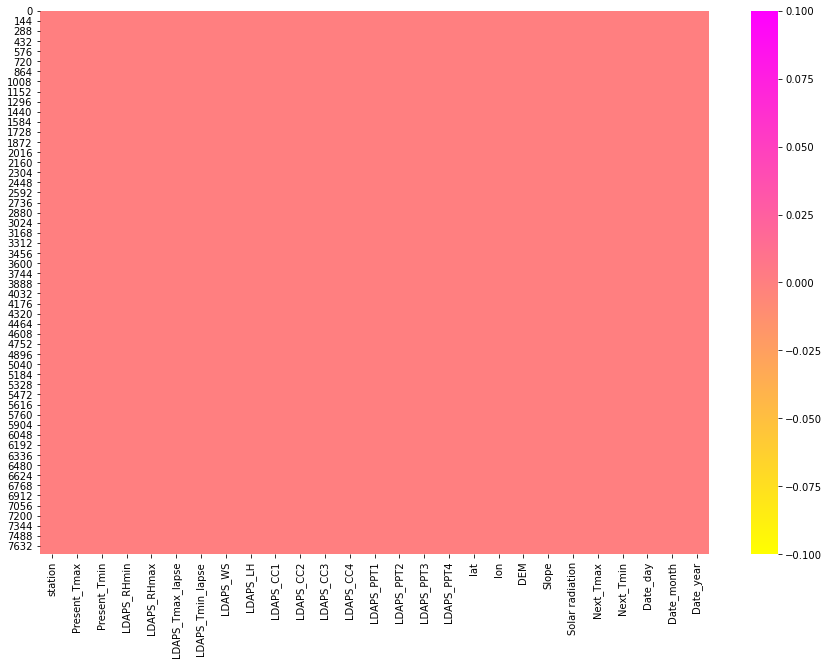

In [30]:
# Let's visualize the null values 
plt.figure(figsize=(15,10))
sns.heatmap(df.isnull(),cmap="spring_r")
plt.show()

We can observe that there are no null values in the dataset

# Shuffling the dataset

We can notice that the dataset is orderly arranged by "Date" and "station" columns so we will shuffle the dataset to avoid the problem while building the models and to get better results.

In [31]:
#Shuffling the dataset
df = shuffle(df)
df

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Date_day,Date_month,Date_year
3771,22.0,29.9,24.2,56.717537,92.872849,27.906068,24.095318,5.987904,68.179614,0.439527,0.681677,0.168592,0.006974,0.000000,0.077941,0.002864,0.000000,37.5102,127.086,21.9668,0.1332,5520.055176,29.9,24.9,26,7,2015
2342,18.0,34.0,26.7,48.129147,93.370682,33.475708,24.597626,5.320925,91.686621,0.391180,0.219063,0.283647,0.235459,0.034624,0.000000,0.000000,0.000000,37.4832,127.024,56.4448,1.2313,5413.949219,36.1,24.7,31,7,2014
5861,12.0,32.1,24.9,39.832954,78.162201,34.420490,25.863253,6.036167,42.057654,0.048416,0.125299,0.173386,0.336521,0.000000,0.000000,0.036060,0.615140,37.5507,126.988,132.1180,0.5931,4951.879883,33.8,25.0,17,8,2016
1152,3.0,32.5,26.1,44.039589,84.804619,33.906595,27.687221,7.497149,14.935814,0.498688,0.363711,0.084931,0.047360,0.023434,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.2661,5002.308105,31.9,26.2,15,8,2013
2109,10.0,27.4,23.6,61.000595,97.149063,27.089540,22.744287,10.499037,82.582869,0.935247,0.721194,0.180928,0.351945,7.062491,1.255959,0.000000,0.000000,37.4562,126.955,208.5070,5.1782,5611.352539,24.7,20.8,22,7,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6582,8.0,27.0,23.5,84.219055,94.440018,26.854626,23.743149,8.431623,38.753115,0.830995,0.897283,0.741149,0.565121,18.738760,2.501365,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5719.192871,29.1,23.0,15,7,2017
3476,2.0,33.9,20.6,40.885384,74.521034,29.022835,20.278393,12.682362,91.092428,0.138502,0.147557,0.109535,0.018115,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.5141,5727.288086,28.6,19.8,15,7,2015
1400,1.0,29.4,20.4,44.831951,80.271233,29.595940,22.042964,7.274261,85.155525,0.029935,0.000081,0.000098,0.000000,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,4806.717773,29.6,21.3,25,8,2013
2653,4.0,27.0,22.6,77.967445,99.289787,23.761913,20.034658,4.685262,50.480330,0.675253,0.645216,0.459328,0.502534,0.603699,0.000000,0.004370,0.000000,37.6450,127.022,45.7160,2.5348,5056.626465,24.0,21.2,13,8,2014


In [32]:
# To get good overview of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7752 entries, 3771 to 4757
Data columns (total 27 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7752 non-null   float64
 1   Present_Tmax      7752 non-null   float64
 2   Present_Tmin      7752 non-null   float64
 3   LDAPS_RHmin       7752 non-null   float64
 4   LDAPS_RHmax       7752 non-null   float64
 5   LDAPS_Tmax_lapse  7752 non-null   float64
 6   LDAPS_Tmin_lapse  7752 non-null   float64
 7   LDAPS_WS          7752 non-null   float64
 8   LDAPS_LH          7752 non-null   float64
 9   LDAPS_CC1         7752 non-null   float64
 10  LDAPS_CC2         7752 non-null   float64
 11  LDAPS_CC3         7752 non-null   float64
 12  LDAPS_CC4         7752 non-null   float64
 13  LDAPS_PPT1        7752 non-null   float64
 14  LDAPS_PPT2        7752 non-null   float64
 15  LDAPS_PPT3        7752 non-null   float64
 16  LDAPS_PPT4        7752 non-null   float

# Observations

Here we can observe all the columns have float data type except Day, Month and Year which have integer data type.

In [33]:
# Checking number of unique values in each column
df.nunique()

station               25
Present_Tmax         168
Present_Tmin         156
LDAPS_RHmin         7673
LDAPS_RHmax         7664
LDAPS_Tmax_lapse    7676
LDAPS_Tmin_lapse    7675
LDAPS_WS            7675
LDAPS_LH            7675
LDAPS_CC1           7570
LDAPS_CC2           7583
LDAPS_CC3           7599
LDAPS_CC4           7524
LDAPS_PPT1          2812
LDAPS_PPT2          2510
LDAPS_PPT3          2356
LDAPS_PPT4          1918
lat                   12
lon                   25
DEM                   25
Slope                 27
Solar radiation     1575
Next_Tmax            184
Next_Tmin            158
Date_day              21
Date_month            12
Date_year              5
dtype: int64

These are the number of unique values present in each column.

In [34]:
# Checking the list of counts of one target column Next_Tmax
df['Next_Tmax'].value_counts()

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
20.9      1
18.9      1
18.6      1
37.4      1
19.7      1
Name: Next_Tmax, Length: 184, dtype: int64

These are the value counts of the target Next_Tmax.

In [35]:
# Checking the list of counts of another target column Next_Tmin
df['Next_Tmin'].value_counts()

23.5    159
23.4    157
24.0    156
23.2    150
23.8    149
       ... 
13.4      1
12.9      1
28.2      1
29.5      1
13.6      1
Name: Next_Tmin, Length: 158, dtype: int64

These are the value counts of the target Next_Tmin.

# Data Visualization

## Univariate Analysis

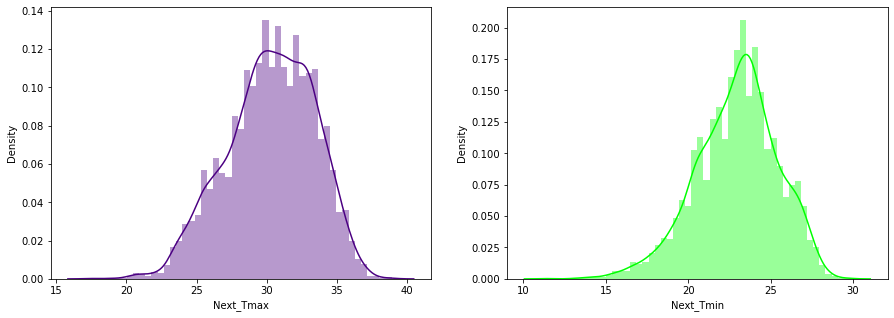

In [36]:
# Plotting distribution plots for the target columns
fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['Next_Tmax'], ax=ax[0],color='indigo')

sns.distplot(df['Next_Tmin'], ax=ax[1],color='lime')

fig.show()

# Observations

From the above plot we can observe that 

- The data is normally distributed in both the target variabes Next_Tmax and Next_Tmin 
- Since the data is symmetric there is no skewness present in these columns.


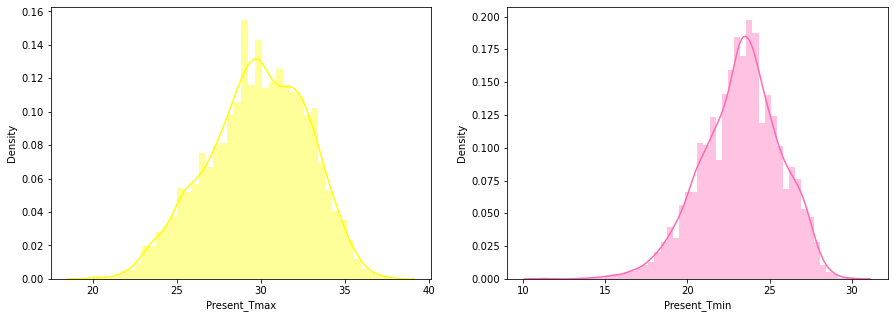

In [37]:
# Plotting distribution plots for Present_Tmax and Present_Tmin variables 

fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['Present_Tmax'], ax=ax[0],color='yellow')

sns.distplot(df['Present_Tmin'], ax=ax[1],color='hotpink')

fig.show()

# Observations
Here also the data is symmetric and normally distributed in both the columns and there is no skewness present in the data.

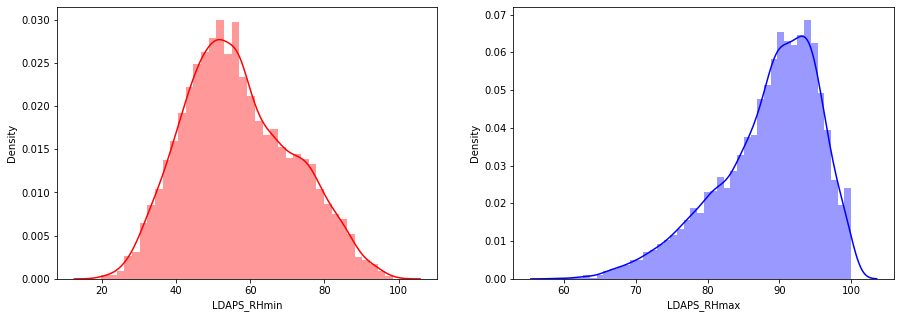

In [38]:
# Plotting distribution plots variables LDAPS_RHmin and LDAPS_RHmax

fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['LDAPS_RHmin'], ax=ax[0],color='red')

sns.distplot(df['LDAPS_RHmax'], ax=ax[1],color='blue')

fig.show()

# Observations
- The data is symmetric and normally distributed in LDAPS_RHmin column also there is no skewness in the data.
- The data is almost normal in LDAPS_RHmax column but it is slightly skewed to left since the median is more than the mean.

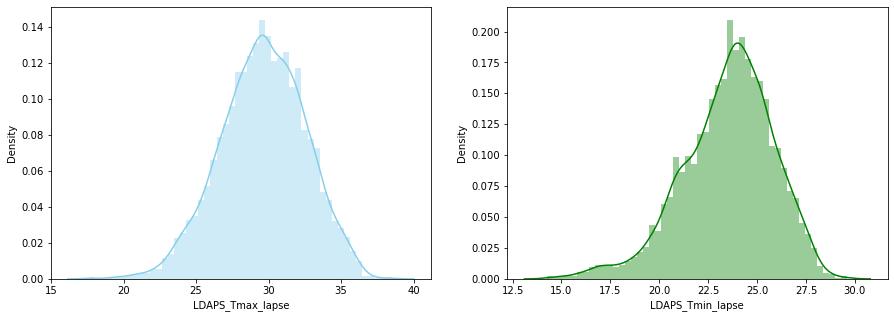

In [39]:
# Plotting distribution plots variables LDAPS_Tmax_lapse and LDAPS_Tmin_lapse

fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['LDAPS_Tmax_lapse'], ax=ax[0],color='skyblue')

sns.distplot(df['LDAPS_Tmin_lapse'], ax=ax[1],color='green')

fig.show()

# Observations
- The data is normally distributed in both the columns.
- There is no skewness in the column LDAPS_Tmax_lapse but the column LDAPS_Tmin_lapse is bit skewed to left.

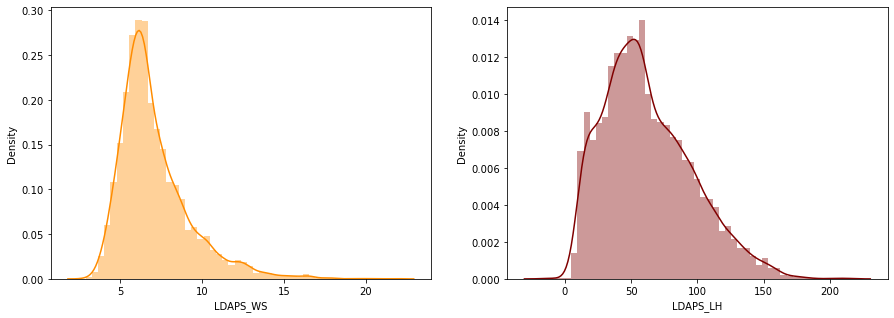

In [40]:
# Plotting distribution plots variables LDAPS_WS and LDAPS_LH

fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['LDAPS_WS'], ax=ax[0],color='darkorange')

sns.distplot(df['LDAPS_LH'], ax=ax[1],color='maroon')

fig.show()

# Observations
- The data is almost normal in both the columns but the median is greater than the mean in the columns, hence they are slightly skewed to right.

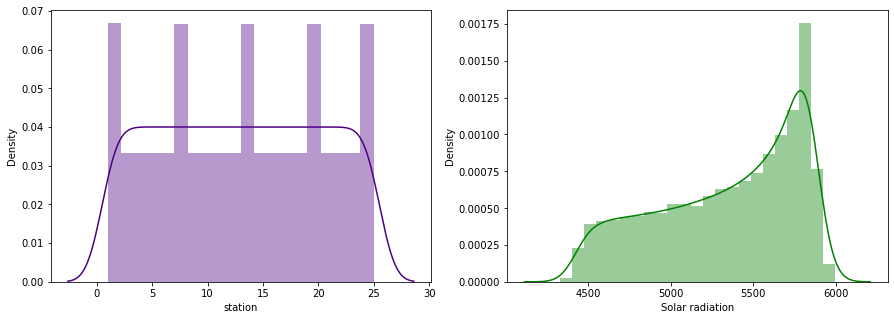

In [41]:
# Plotting distribution plots variables station and Solar radiation

fig,ax =plt.subplots(1,2, figsize=(15,5))

sns.distplot(df['station'], ax=ax[0],color='indigo')

sns.distplot(df['Solar radiation'], ax=ax[1],color='green')

fig.show()

# Observations
- The data is normally distributed in station column and there is no skewness present in this column.
- The mean is less than median in Solar radiation column so the data is skewed to left in this column.

In [42]:
# Seperating columns
categorical_col = [ 'lat','lon','station','DEM','Slope','Date_day','Date_month', 'Date_year']
columns = [ 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 
        'Solar radiation']
target = [ 'Next_Tmax', 'Next_Tmin']

## Histogram

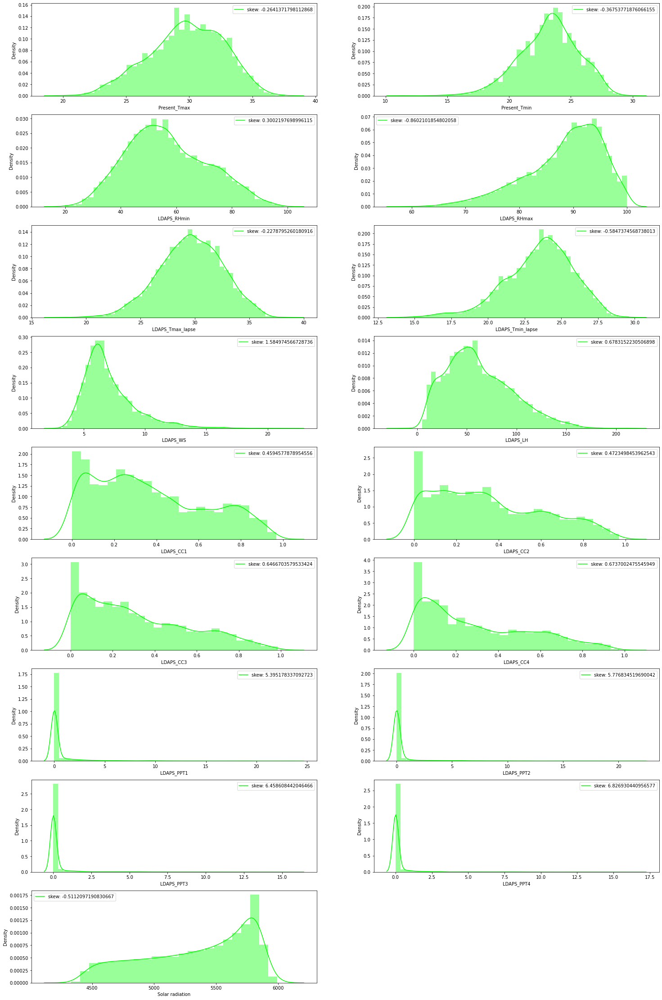

In [43]:
# Histograms of Continous Features

plt.figure(figsize=(25,40))
k =1
for i in columns:
    plt.subplot(9,2,k)
    
    sns.distplot(df[i],color='lime')
    plt.legend(['skew: '+str(df[i].skew())])
    k = k+1

# OBSERVATIONS
From the above distribution plot we can observe that 
- The data is almost normal in first three columns.
- Most of the columns have right skewness and the data is not normal in those columns.
- LDAPS FEATURES , LDAPS PPT1,2,3,4 are highly skewed with vlaues highly belonging to 0.

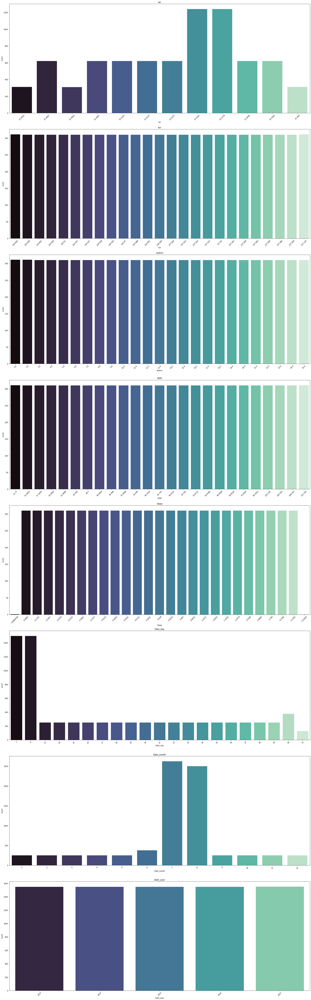

In [44]:
# Plotting count plots for the categorical columns
plt.figure(figsize=(25,80))
c=1
for i in categorical_col:
   
    plt.subplot(8,1,c)
    c=c+1
    sns.countplot(df[i],palette='mako')
    plt.title(i)
    plt.xticks(rotation=45)
plt.tight_layout()

# Observations
From the above count plots we can observe that 
- The latitudes 37.5507 and 37.5776 have high number of observations and 37.4562 has recorded least number of observations
- All the longitudes are similar in count
- All the stations have same count of observations
- All the DEM have same count of observations
- All the slope have equal count of observations
- Date_Day has high number of observations on 7 and 8, where the other days have similar count of observations
- Date_Month has high number of observations on 7 and 8, where the other months have similar count of observations
- Date_year has equal number of observations for all the years

## Bivariate Analysis

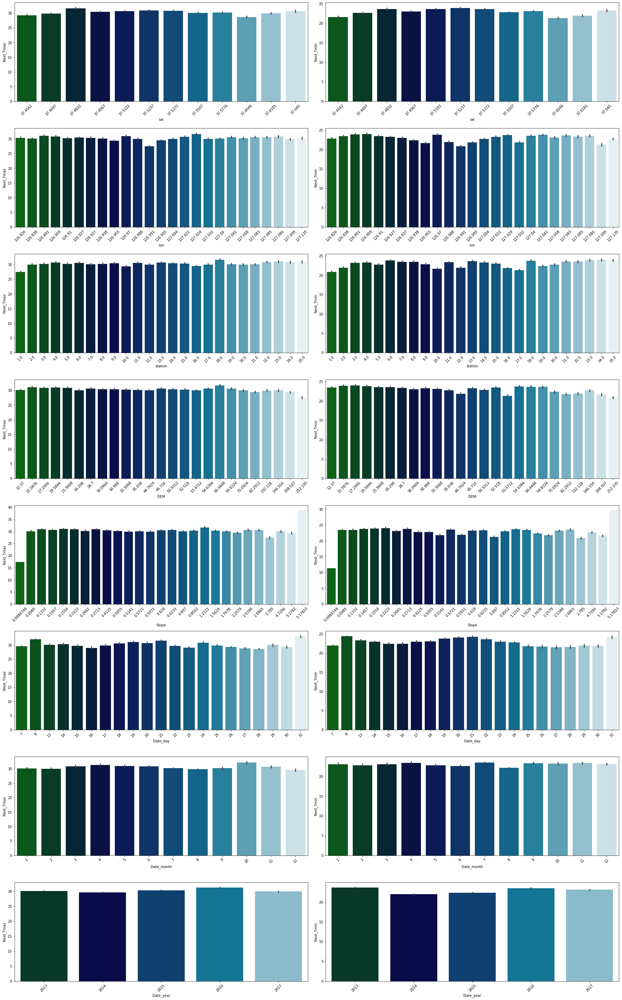

In [45]:
plt.figure(figsize=(25,40))
c=1
for i in categorical_col:
    for j in ['Next_Tmax','Next_Tmin']:
        plt.subplot(8,2,c)
        c=c+1
        sns.barplot(df[i],df[j],palette='ocean')
        plt.xticks(rotation=45)
plt.tight_layout()

# Observations
- Year , Dem, station  doesnot seem to have much influence on Target Variable.
- 10th month seem to have highest average mean maxT Tempreture.
- Month 8 has lowest average mean minT tempreture.
- 31 of the day seems to have Highest mean of max_Temp and min_temp.
- Lowest value of slope has lowest mean avg of maxT and minT, Highest Slope Value has Highest Average MaxT and MinT
- The station 18 has highest temperature collection for both Next_Tmax and Next_Tmin targets while station 1 observes lowest temperature for both the targets. This could be because of the stations location.
- 

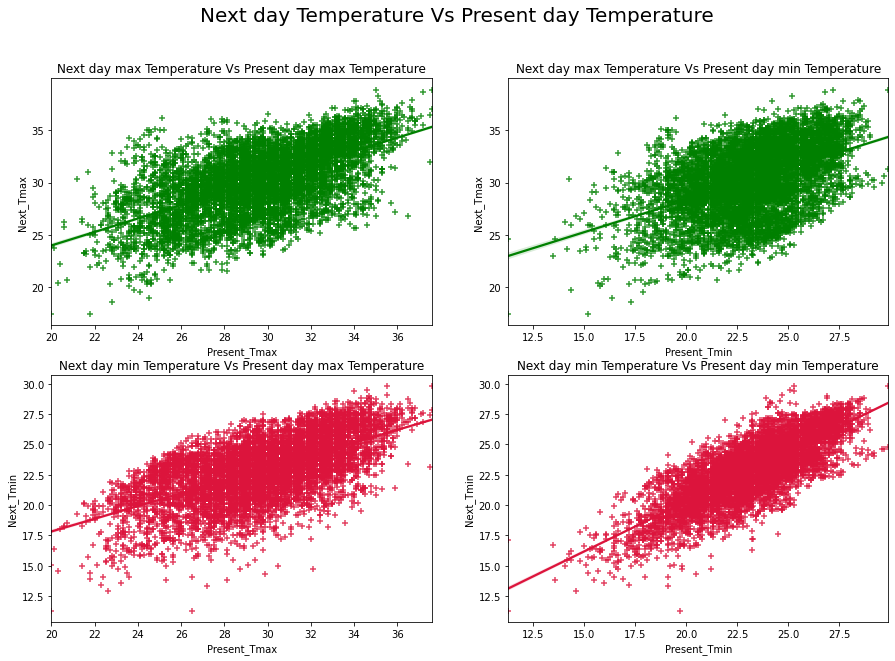

In [46]:
# Comparing Next day temperature and Present day temperature

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Present day Temperature',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Present day max Temperature')
sns.regplot(x='Present_Tmax',y='Next_Tmax',data=df,marker="+",color='g')

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs Present day min Temperature')
sns.regplot(x='Present_Tmin',y='Next_Tmax',data=df,marker="+",color='g')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs Present day max Temperature')
sns.regplot(x='Present_Tmax',y='Next_Tmin',data=df,marker="+",color='crimson')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs Present day min Temperature')
sns.regplot(x='Present_Tmin',y='Next_Tmin',data=df,marker="+",color="crimson")
plt.show()

# Observations
- Present_Tmax and Present_Tmin columns has the data of maximum and minimum air temperature of the present day.
- There is a strong linear relationship between the Next day temperature and Present day temperature.
- Present_Tmin column has bit less relation with Next_Tmin compared to others.
- As Present day Tmax and Tmin increases then Next_Tmin and Next_Tmax temperature also increases

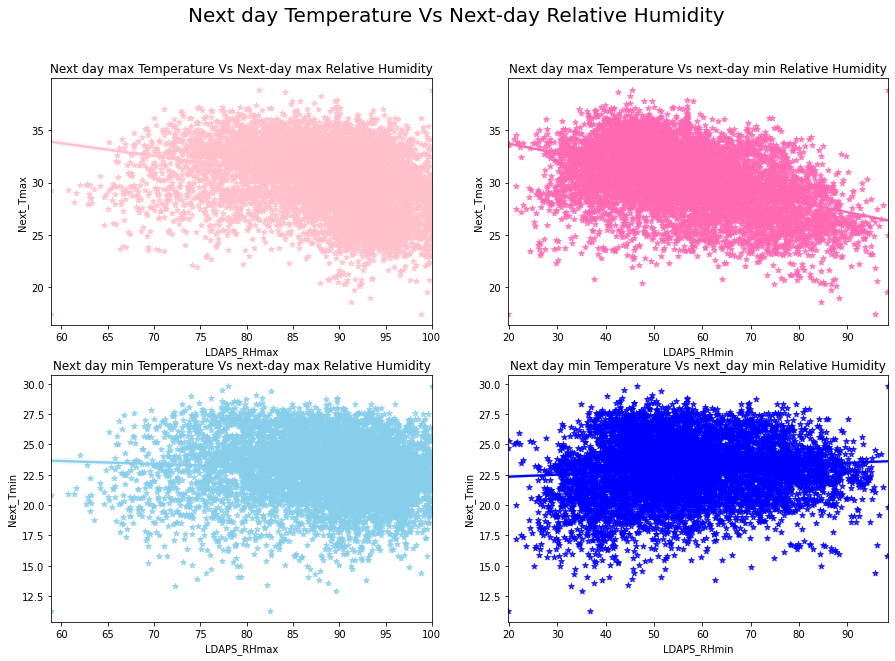

In [47]:
# Comparing Next day temperature and next day Relative Humidity

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Next-day Relative Humidity',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day max Relative Humidity')
sns.regplot(x='LDAPS_RHmax',y='Next_Tmax',data=df,marker="*",color='pink')

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day min Relative Humidity')
sns.regplot(x='LDAPS_RHmin',y='Next_Tmax',data=df,marker="*",color='hotpink')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day max Relative Humidity')
sns.regplot(x='LDAPS_RHmax',y='Next_Tmin',data=df,marker="*",color='skyblue')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day min Relative Humidity')
sns.regplot(x='LDAPS_RHmin',y='Next_Tmin',data=df,marker="*",color="blue")
plt.show()

# Observations
- The columns LDAPS_RHmax and LDAPS_RHmin contains the forecast of next-day maximum and minimum Relative humidity in percentage(%) respectively.
- Next day Tmax decreases with increase in LDAPS_RHmax and LDAPS_RHmin but it is not true in case of Next_Tmin, as Next day Tmin seems to be unaffected by RHmax and we can also observe slight positive correlation between Next_Tmin and RHmin.

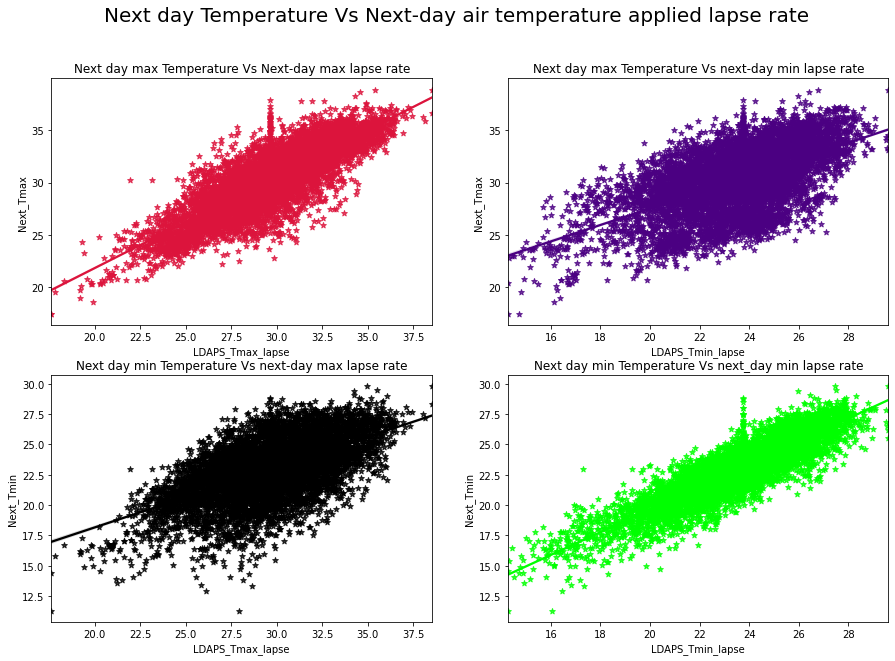

In [48]:
# Comparing Next day temperature and next day air temperature applied lapse rate (Â°C)

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Next-day air temperature applied lapse rate',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day max lapse rate')
sns.regplot(x='LDAPS_Tmax_lapse',y='Next_Tmax',data=df,marker="*",color='crimson')

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day min lapse rate')
sns.regplot(x='LDAPS_Tmin_lapse',y='Next_Tmax',data=df,marker="*",color='indigo')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day max lapse rate')
sns.regplot(x='LDAPS_Tmax_lapse',y='Next_Tmin',data=df,marker="*",color='k')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day min lapse rate')
sns.regplot(x='LDAPS_Tmin_lapse',y='Next_Tmin',data=df,marker="*",color="lime")
plt.show()

# Observations
- LDAPS_Tmax_lapse and LDAPS_Tmin_lapse is forecast of next-day maximum and minimum air temperature applied lapse rate (Â°C) respectively.
- There is a strong positive linear relationship between target variables Next day temperature and Next day air temperature applied lapse rate.
- As Next day air temperature applied lapse rate increases, Next day temperature is also increasing.

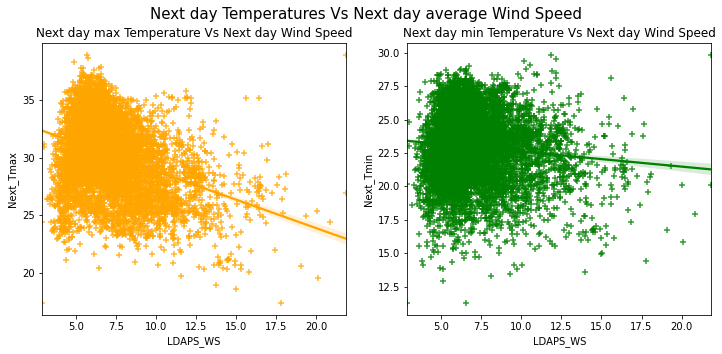

In [49]:
# Comparing Next day temperature and  Next day Average Wind Speed

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average Wind Speed',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmax',data=df,marker='+',color="orange")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day Wind Speed') 
sns.regplot(x='LDAPS_WS',y='Next_Tmin',data=df,marker='+',color="green")
plt.show()

# Observations
- LDAPS_WS is forecast of next-day average wind speed in (m/s).
- There is very less relation of wind speed with the target variables. As wind speed increases, Next day temperature decreases also Next day Tmax seems to decrease more drastically compared to Next day Tmin.
- From the graph we can observe the Wind Speed is mostly 2.8 to 10 m/s.

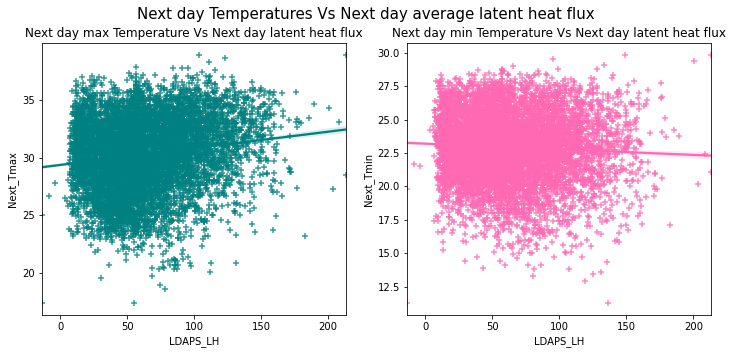

In [50]:
# Comparing Next day temperature and  Next day Average latent heat flux (W/m2)

plt.figure(figsize=(12,5))
plt.suptitle('Next day Temperatures Vs Next day average latent heat flux',fontsize=15)

plt.subplot(1,2,1)
plt.title('Next day max Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmax',data=df,marker='+',color="teal")

plt.subplot(1,2,2)
plt.title('Next day min Temperature Vs Next day latent heat flux') 
sns.regplot(x='LDAPS_LH',y='Next_Tmin',data=df,marker='+',color="hotpink")
plt.show()

# Observations
- LDAPS_LH gives the forecast of next-day average latent heat flux (W/m2).
- From the plot we can notice there is no linear relation between targets and the features.
- As Latent heat flux increases, Next day Tmax is also increases slightly while Next day Tmin decreases.
- The Latent heat flux mostly distributed in the range of 10 to 160 W/m2.

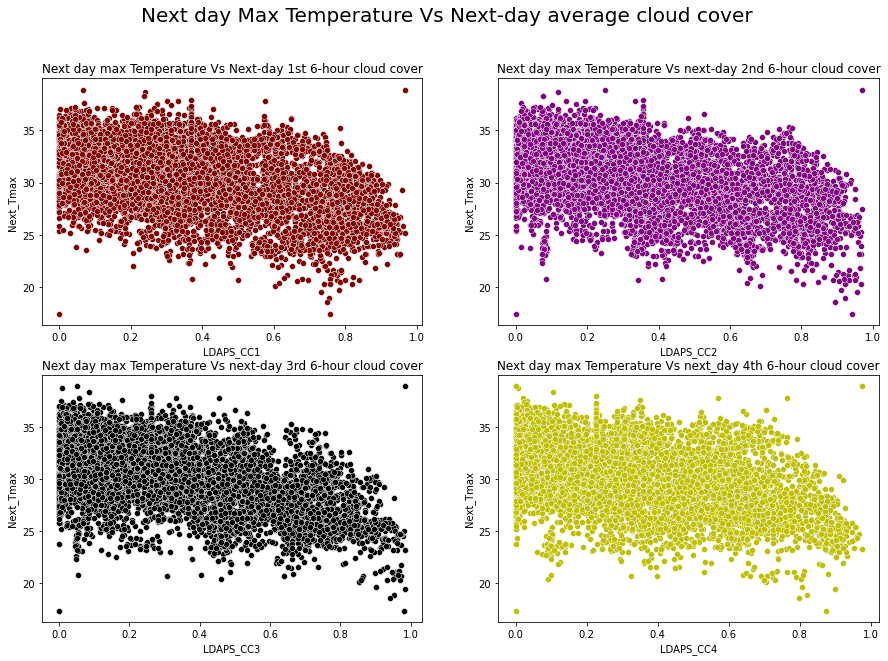

In [51]:
# Comparing Next day maximnum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmax',data=df,color="maroon")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmax',data=df,color='purple')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmax',data=df,color='k')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmax',data=df,color="y")
plt.show()

# Observations
- By observing the plot we can infer that the column Next_Tmax goes on decreasing as the cloud cover increases irrespective of any split.
- The cloud cover liesin the range of 0 to 0.97%. Also we can say there is negative linear relation between the targets and the cloud cover.

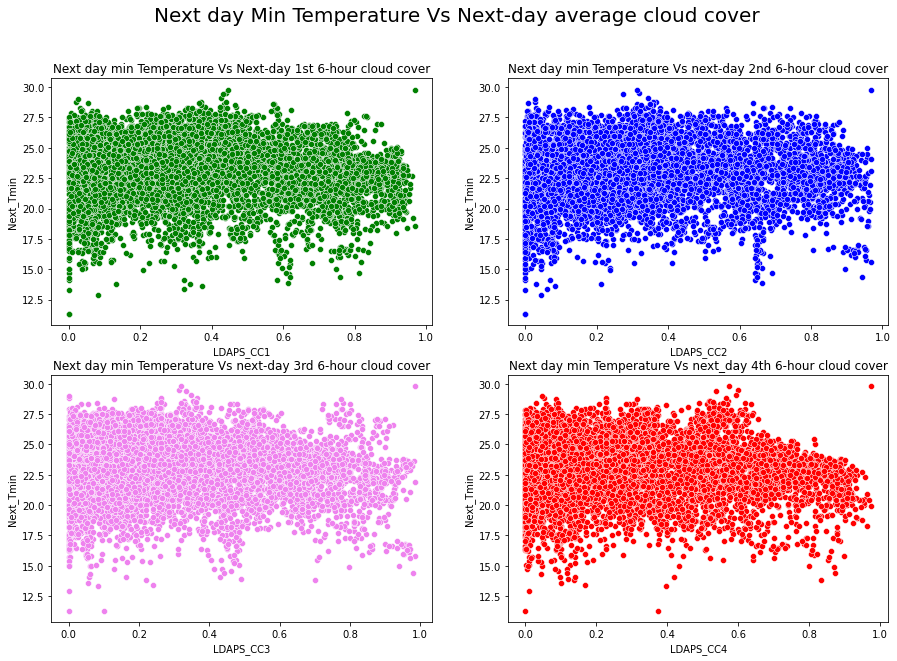

In [52]:
# Comparing Next day minimum temperature and next day average cloud cover

plt.figure(figsize=(15,10))
plt.suptitle('Next day Min Temperature Vs Next-day average cloud cover',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs Next-day 1st 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC1',y='Next_Tmin',data=df,color="g")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs next-day 2nd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC2',y='Next_Tmin',data=df,color='b')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day 3rd 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC3',y='Next_Tmin',data=df,color='violet')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day 4th 6-hour cloud cover')
sns.scatterplot(x='LDAPS_CC4',y='Next_Tmin',data=df,color="r")
plt.show()

# Observations
- There is no significant relation between Next day temperature and cloud cover.
- We can say that Next_Tmin remains unaffected by cloud cover. And it ranges between 0-0.98%.

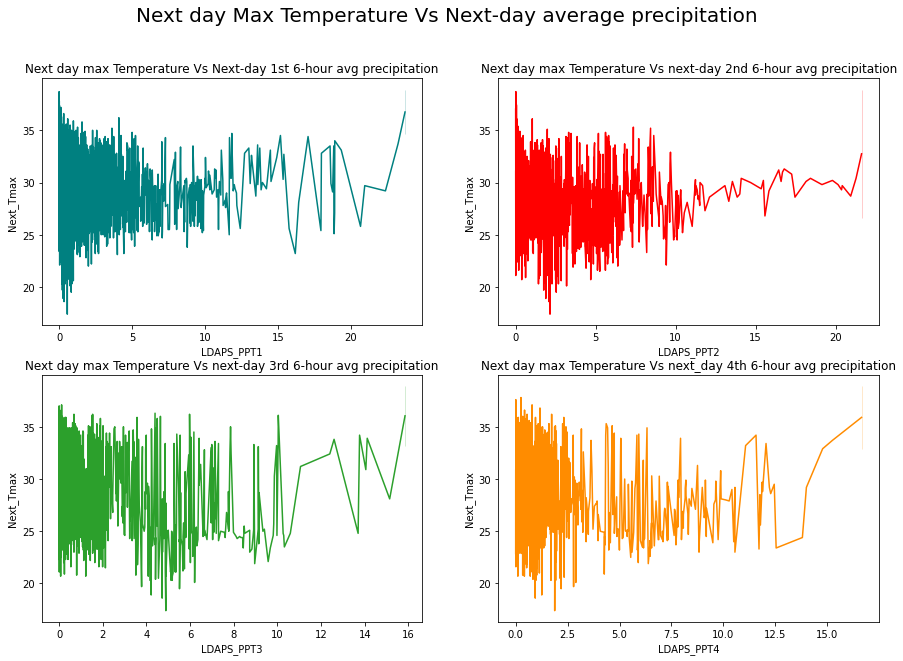

In [53]:
# Comparing Next day maximnum temperature and next day average precipitation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Max Temperature Vs Next-day average precipitation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Next-day 1st 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT1',y='Next_Tmax',data=df,color="teal")

plt.subplot(2,2,2)
plt.title('Next day max Temperature Vs next-day 2nd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT2',y='Next_Tmax',data=df,color='r')

plt.subplot(2,2,3)
plt.title('Next day max Temperature Vs next-day 3rd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT3',y='Next_Tmax',data=df,color='tab:green')

plt.subplot(2,2,4)
plt.title('Next day max Temperature Vs next_day 4th 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT4',y='Next_Tmax',data=df,color="darkorange")
plt.show()

# Observations
- There is no relation between average precipitation and Next day temperature.
- Next_Tmax decreases as average precipitation increases irrespective of any split.
- We can observe the average precipitation distributed mostly between 0-5% in PPT1, 0-10% in PPT2, 0-7% in PPT3 and 0-2.5% in PPT4.

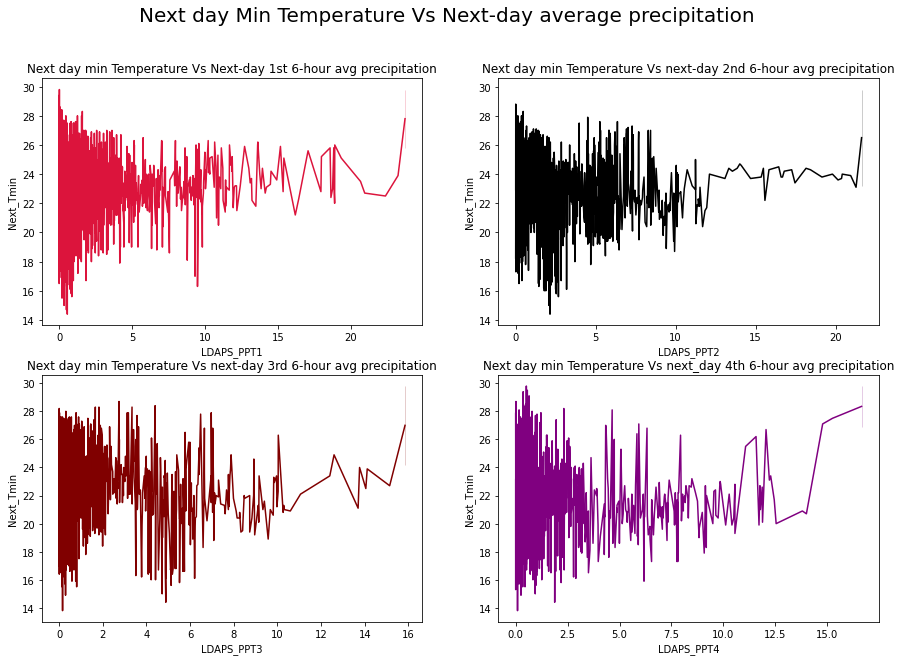

In [54]:
# Comparing Next day minimum temperature and next day average precipitation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Min Temperature Vs Next-day average precipitation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs Next-day 1st 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT1',y='Next_Tmin',data=df,color="crimson")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs next-day 2nd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT2',y='Next_Tmin',data=df,color='k')

plt.subplot(2,2,3)
plt.title('Next day min Temperature Vs next-day 3rd 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT3',y='Next_Tmin',data=df,color='maroon')

plt.subplot(2,2,4)
plt.title('Next day min Temperature Vs next_day 4th 6-hour avg precipitation')
sns.lineplot(x='LDAPS_PPT4',y='Next_Tmin',data=df,color="purple")
plt.show()

# Observations
- There is no linear relation between average precipitation and Next day temperature.
- Next_Tmin slightly increases as PPT1 and PPT2 increases also as LDAPS_PPT1 goes above 5% then Next_Tmin is above 15 degree.
- The Next_Tmin slightly decreases as LDAPS_PPT3 and LDAPS_PPT4 increases.

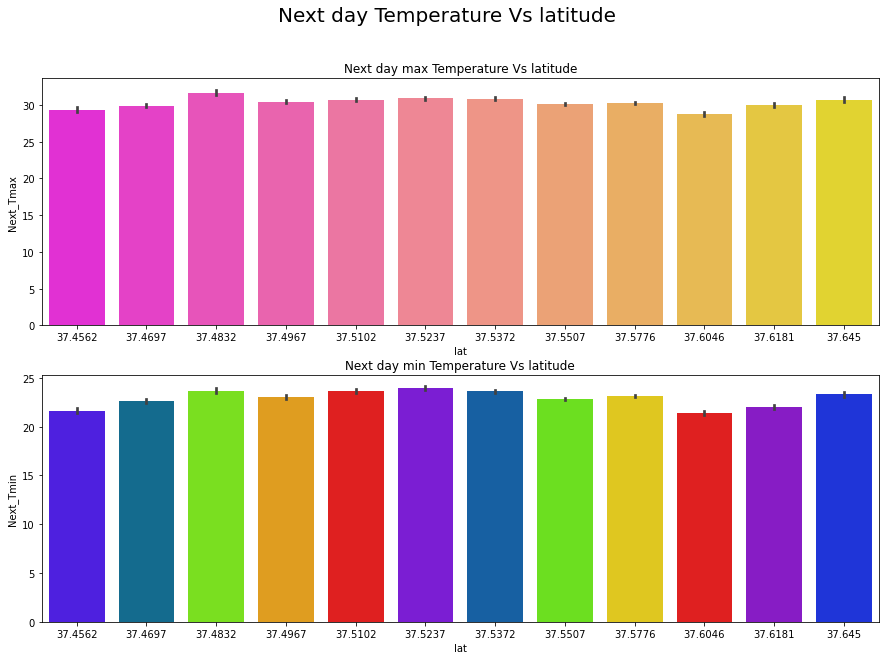

In [55]:
# Comparing Next day temperature and latitude

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs latitude',fontsize=20)

plt.subplot(2,1,1)
plt.title('Next day max Temperature Vs latitude')
sns.barplot(x='lat',y='Next_Tmax',data=df,palette="spring")

plt.subplot(2,1,2)
plt.title('Next day min Temperature Vs latitude')
sns.barplot(x='lat',y='Next_Tmin',data=df,palette="prism")
plt.show()

# Observations

- The highest temperature is observed at latitude range 37.4832 for Next_Tmax but this is not the case for Next_Tmin, that could be because of other factors affect the temperature.
- Also the temperature seems to fall down as latitude increases in both the cases.

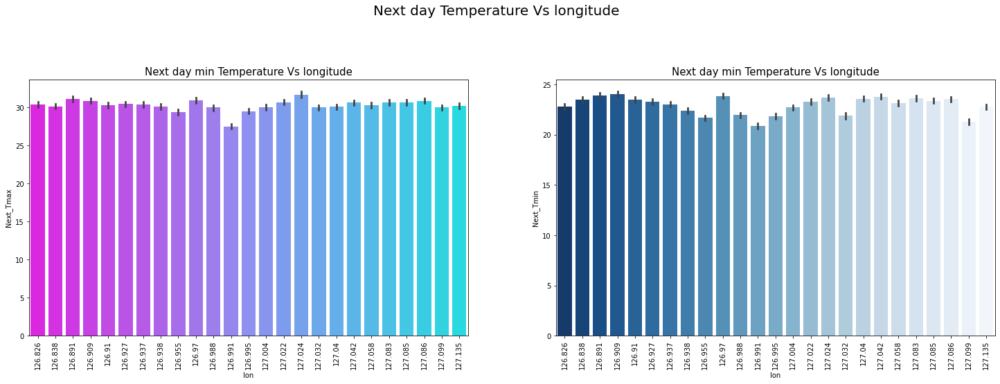

In [56]:
# Comparing Next day temperature and longitude

plt.figure(figsize=(25,15))
plt.suptitle('Next day Temperature Vs longitude',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day min Temperature Vs longitude',fontsize=15)
sns.barplot(x='lon',y='Next_Tmax',data=df,palette="cool_r")
plt.xticks(rotation=90)

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs longitude',fontsize=15)
sns.barplot(x='lon',y='Next_Tmin',data=df,palette="Blues_r")
plt.xticks(rotation=90)
plt.show()

# Observations
- From the graph we can say that longitude is not affecting much Next day temperature. As the longitude increases, Next_Tmax also increases for first three longitudes and then it decreases. This increase and decrease continuous tll the end.
- Same thing happens in the case of Next_Tmin also.

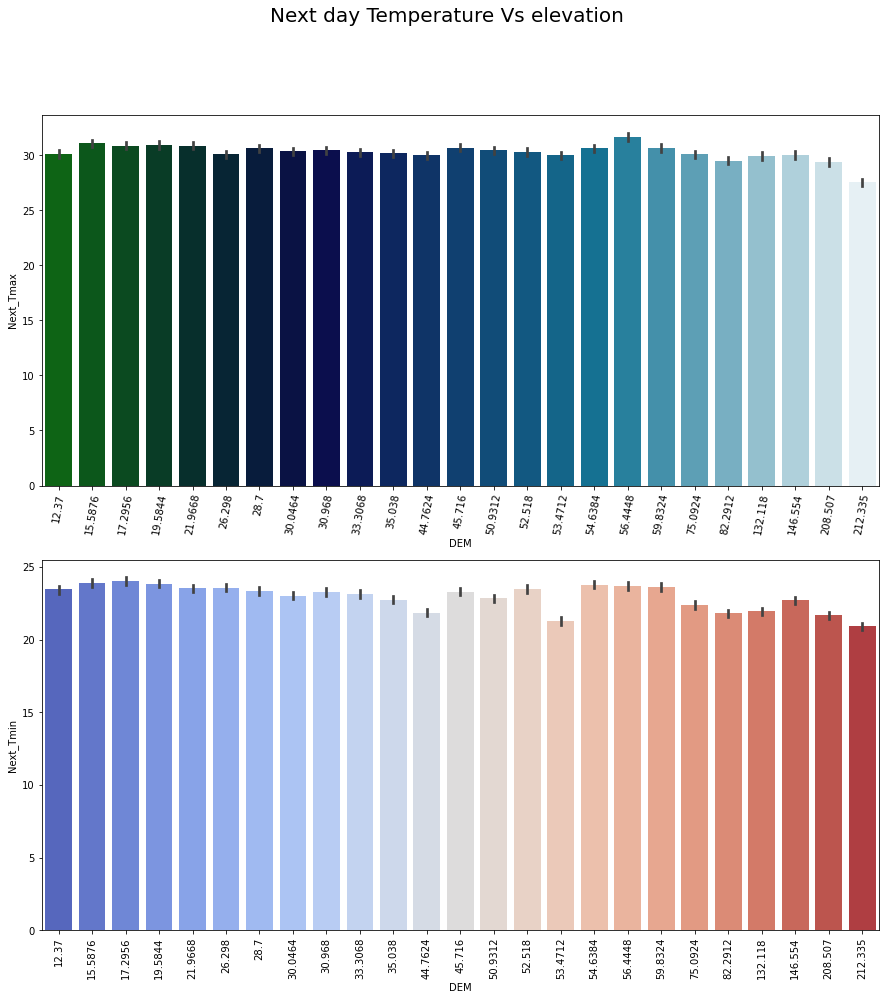

In [57]:
# Comparing Next day temperature and elevation

plt.figure(figsize=(15,15))
plt.suptitle('Next day Temperature Vs elevation',fontsize=20)

plt.subplot(2,1,1)
sns.barplot(x='DEM',y='Next_Tmax',data=df,palette="ocean")
plt.xticks(rotation=80)

plt.subplot(2,1,2)
sns.barplot(x='DEM',y='Next_Tmin',data=df,palette="coolwarm")
plt.xticks(rotation=90)
plt.show()

# Observation
- The highest temperature is observed at the elevation56.4448 for Next_Tmax but this is not the case in Next_Tmin.
- In the first graph we can observe as the elevation increases, temperature decreases. This is true only for last 10 elevations, for remaining elevations are not affecting the temperature that much.
- In the second graph we can infer that the temperature decreases first and then increases and this increase and decrese of temperature is continuing till the end.

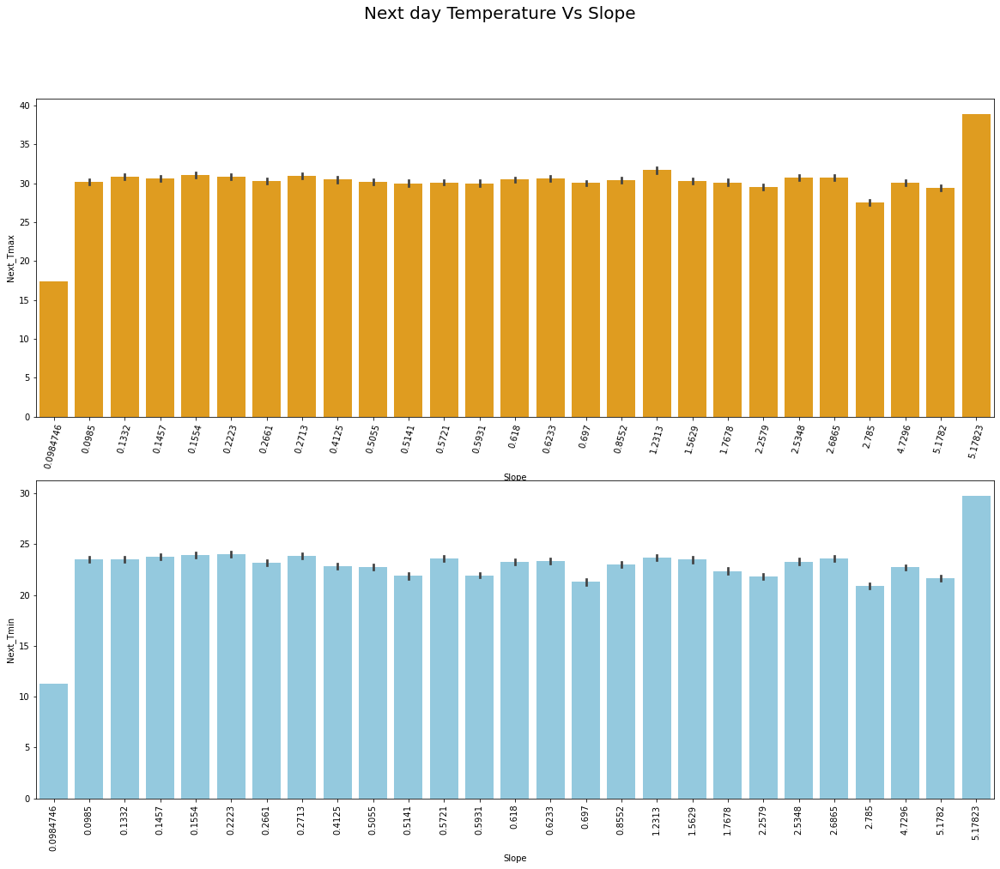

In [58]:
# Comparing Next day temperature and slope

plt.figure(figsize=(20,15))
plt.suptitle('Next day Temperature Vs Slope',fontsize=20)

plt.subplot(2,1,1)
sns.barplot(x='Slope',y='Next_Tmax',data=df,color="orange")
plt.xticks(rotation=75)

plt.subplot(2,1,2)
sns.barplot(x='Slope',y='Next_Tmin',data=df,color="skyblue")
plt.xticks(rotation=90)
plt.show()

# Observation
- From the graph we can see as the slopes increases, the temperature also increases in both the cases.
- Lowest and highest temperatures observed at consecutive slopes 2.785 and 1.2313 respectively in both the cases.

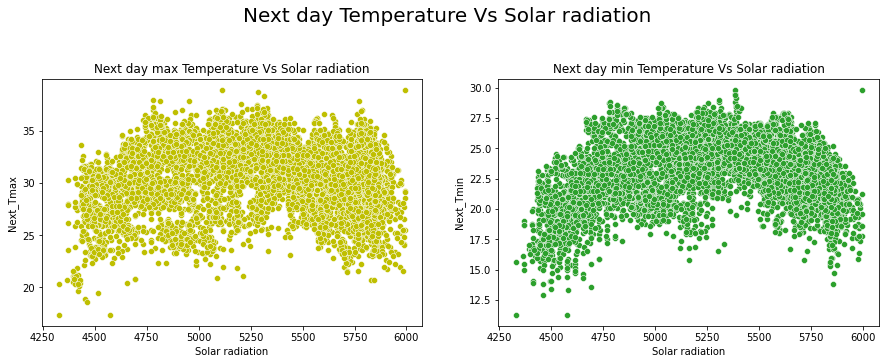

In [59]:
# Comparing Next day temperature and Solar radiation

plt.figure(figsize=(15,10))
plt.suptitle('Next day Temperature Vs Solar radiation',fontsize=20)

plt.subplot(2,2,1)
plt.title('Next day max Temperature Vs Solar radiation')
sns.scatterplot(x='Solar radiation',y='Next_Tmax',data=df,color="y")

plt.subplot(2,2,2)
plt.title('Next day min Temperature Vs Solar radiation')
sns.scatterplot(x='Solar radiation',y='Next_Tmin',data=df,color="tab:green")
plt.show()

# Observation

The solar radiations does not seem to affect the Tmax and Tmin. By looking at the plot we can say that when the daily incoming solar radiations are in the range 4750 to 5300, the temperature is high.

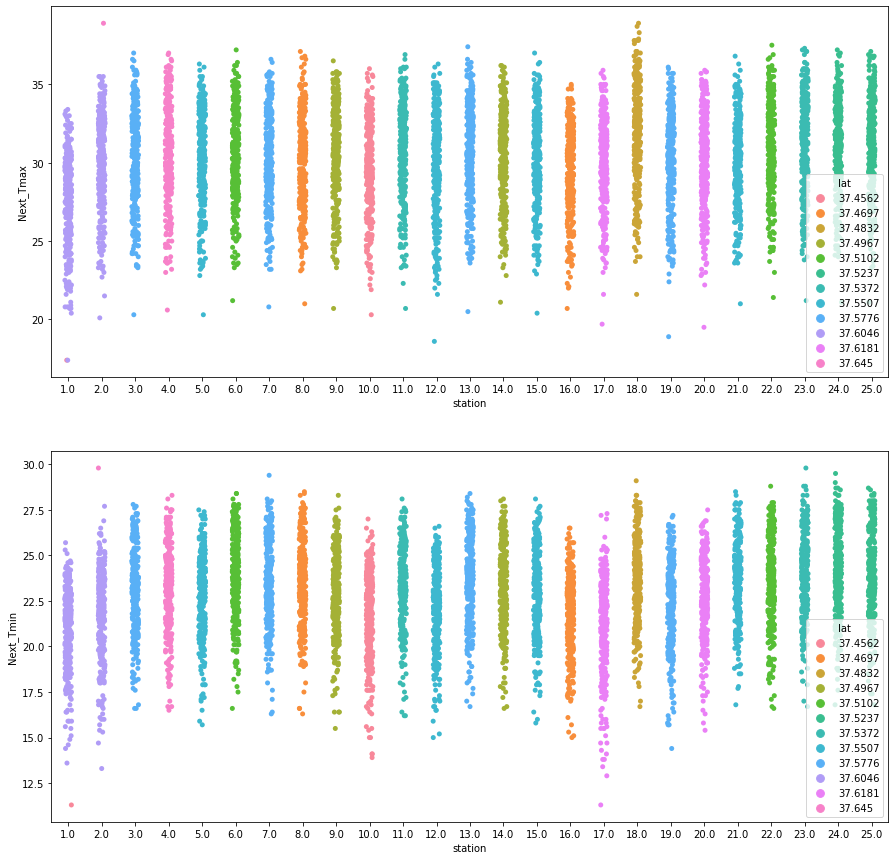

In [60]:
# Visualizing the relation between station and the target variables on the basis of latitude
plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
sns.stripplot(df['station'],df["Next_Tmax"],data=df,hue=df["lat"])
plt.subplot(2,1,2)
sns.stripplot(df['station'],df["Next_Tmin"],data=df,hue=df["lat"])
plt.show()

# Observation
- Each station is located on the particular latitude. There are atmost 3 stations on single latitude.
- As the latitude decreases in each station, the temperture seemd to be increases.

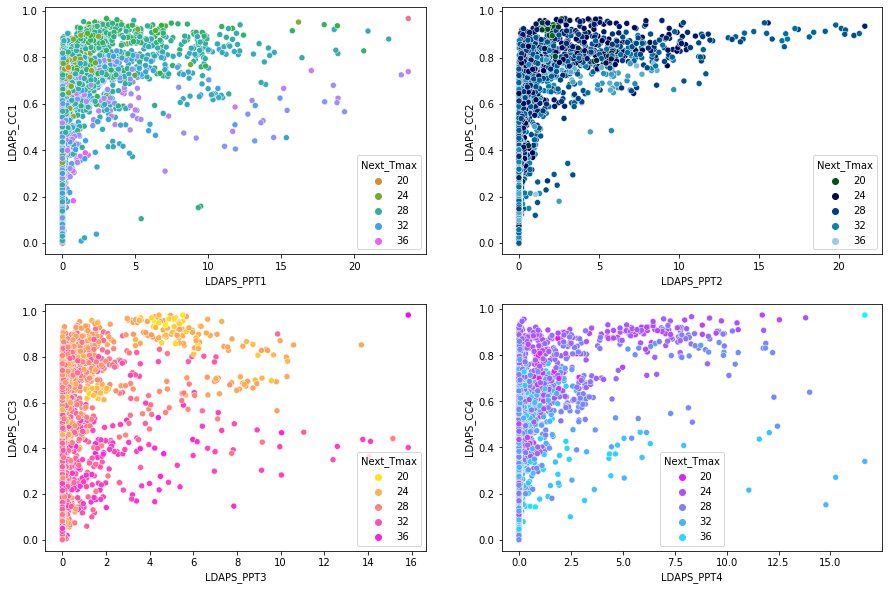

In [61]:
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.scatterplot(x='LDAPS_PPT1',y='LDAPS_CC1',hue='Next_Tmax',data=df,palette="husl")

plt.subplot(2,2,2)
sns.scatterplot(x='LDAPS_PPT2',y='LDAPS_CC2',hue='Next_Tmax',data=df,palette="ocean")

plt.subplot(2,2,3)
sns.scatterplot(x='LDAPS_PPT3',y='LDAPS_CC3',hue='Next_Tmax',data=df,palette="spring_r")

plt.subplot(2,2,4)
sns.scatterplot(x='LDAPS_PPT4',y='LDAPS_CC4',hue='Next_Tmax',data=df,palette="cool_r")
plt.show()

# Observation
- In all the graphs the Next_Tmax is higher when the precipitation and cloud cover both have lower value.
- In the first split of cloud cover and precipitation , precipitation increases after the cloud cover value crosses 0.2 while this threshold increases to 0.5 in 2nd split after that it decreses for all the splits.
- We can observe the presence of outliers from the graph.

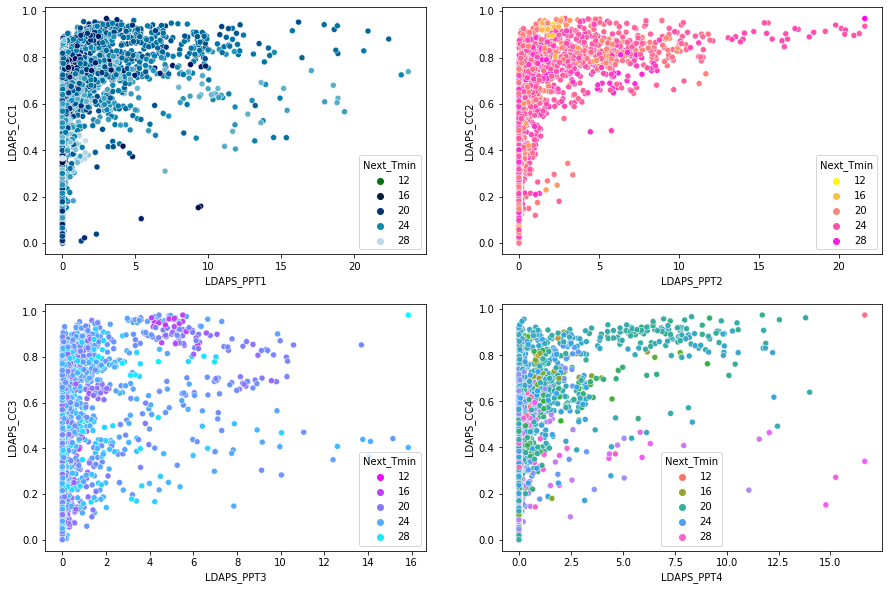

In [62]:
plt.figure(figsize=(15,10))

plt.subplot(2,2,1)
sns.scatterplot(x='LDAPS_PPT1',y='LDAPS_CC1',hue='Next_Tmin',data=df,palette="ocean")

plt.subplot(2,2,2)
sns.scatterplot(x='LDAPS_PPT2',y='LDAPS_CC2',hue='Next_Tmin',data=df,palette="spring_r")

plt.subplot(2,2,3)
sns.scatterplot(x='LDAPS_PPT3',y='LDAPS_CC3',hue='Next_Tmin',data=df,palette="cool_r")

plt.subplot(2,2,4)
sns.scatterplot(x='LDAPS_PPT4',y='LDAPS_CC4',hue='Next_Tmin',data=df,palette="husl")
plt.show()

# Observation
Here also same thing happens that was happend in the case of Tmax. In all the graphs the Next_Tmax is higher when the precipitation and cloud cover both have lower value.
In the first split of cloud cover and precipitation , precipitation increases after the cloud cover value crosses 0.2 while this threshold increases to 0.5 in 2nd split after that it decreses for all the splits.
We can observe the presence of outliers from the graph.

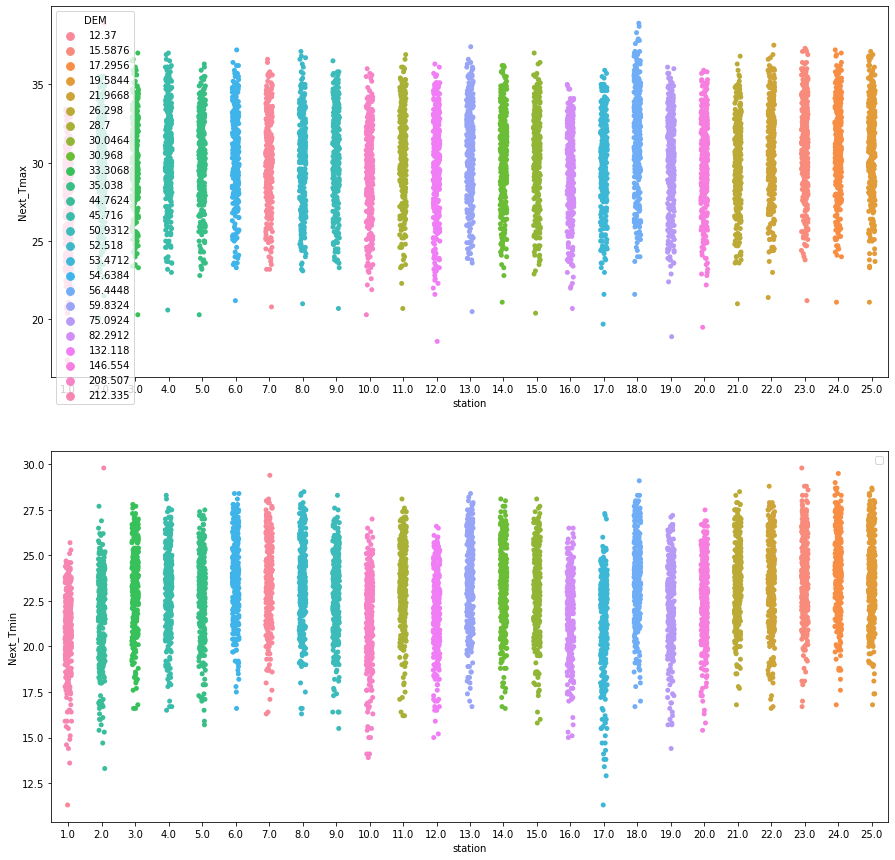

In [63]:
# Visualizing the relation between station and the target variables on the basis of longitude
plt.figure(figsize=(15,15))
plt.subplot(2,1,1)
sns.stripplot(df['station'],df["Next_Tmax"],data=df,hue=df["DEM"])
plt.subplot(2,1,2)
sns.stripplot(df['station'],df["Next_Tmin"],data=df,hue=df["DEM"])
plt.legend("")
plt.show()

# Observation
- From the plot we can coclude that, each station belongs to a particular elevation and there is only one station belonging to particular elevation.
- The highest Tmax is noted at the station 18 which have the elevation 56.4448 and it is not lowest elevation. This indicates that elevation alone does not decide the temperature.

To know the more relation between the variables we will plot pair plot.


## Multivariate Analysis


Since we have two target variables Next_Tmax and Next_Tmin, we will check the pairwise relation of the features with both the targets separately.

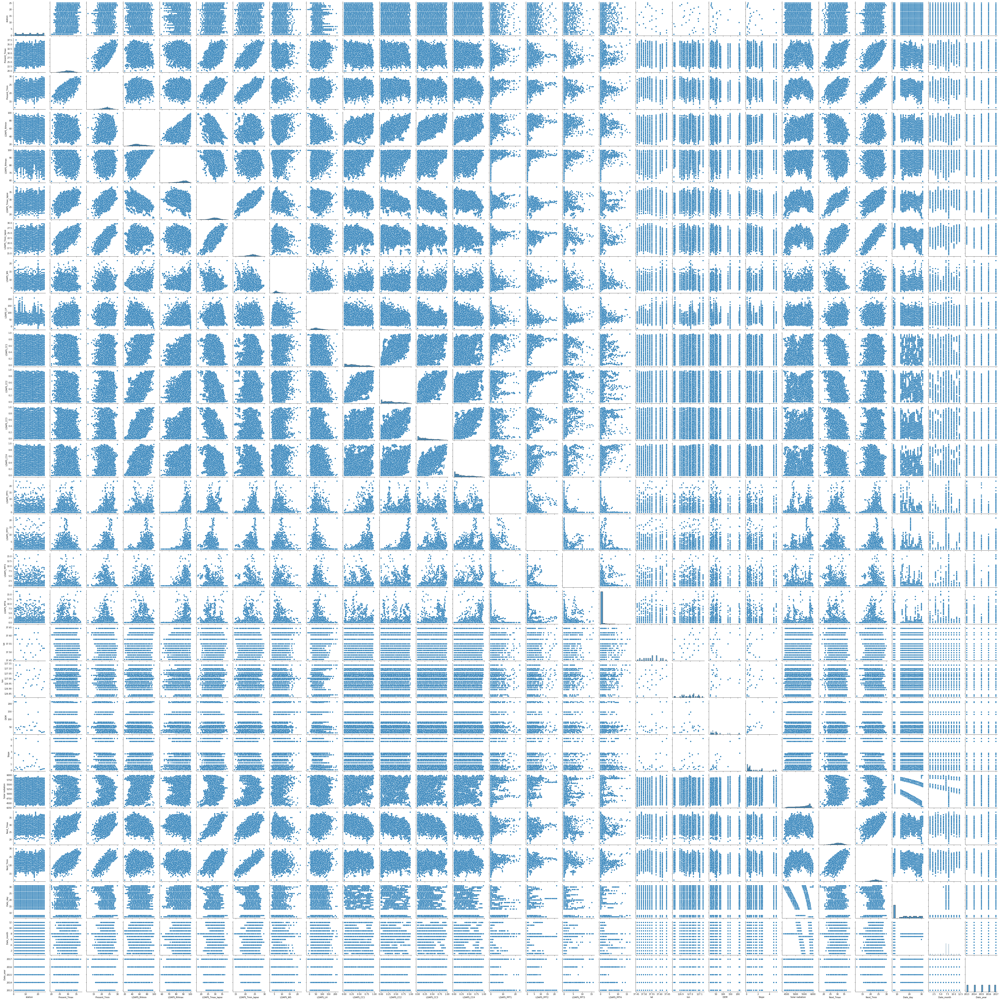

In [67]:
# Checking the pairwise relation between the features and label Next_Tmax.
sns.pairplot(df)

# Observation
- The pairplot gives the pairwise relation between the features on the basis of the targets Next_Tmax. On the diagonal we can notice the distribution plots in the pairplots.
- We can notice most of the feature have strong linear relationship with each other and also we can observe the presence of outliers in many columns. We will indentify the outliers using boxplots.

# Identifying the outliers

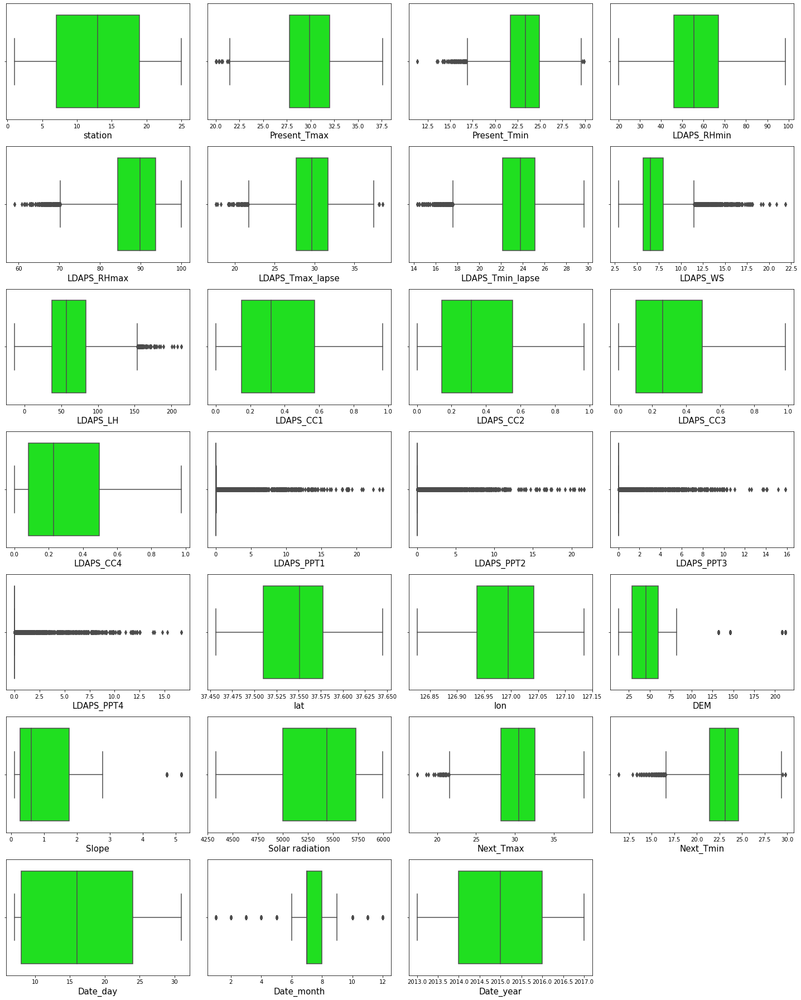

In [68]:
# Identifying the outlierspresent in numerical columns using boxplot

plt.figure(figsize=(20,25),facecolor='white')
plotnumber=1
for column in df.columns:
    if plotnumber<=27:
        ax=plt.subplot(7,4,plotnumber)
        sns.boxplot(df[column],color="lime")
        plt.xlabel(column,fontsize=15)
    plotnumber+=1
plt.tight_layout()

# Observation
The outliers present in the following columns:

- Present_Tmax
- Present_Tmin
- LDAPS_RHmax
- LDAPS_Tmax_lapse
- LDAPS_Tmin_lapse
- LDAPS_WS
- LDAPS_LH
- LDAPS_PPT1
- LDAPS_PPT2
- LDAPS_PPT3
- LDAPS_PPT4
- DEM
- Slope
- Next_Tmax
- Next_Tmin
- Date_month

We will try to remove the outliers from all the features above except target variables using Zscore or IQR method.

# Removing outliers

## I. Zscore method

In [70]:
# Assigning a variable for all the features having outliers
features = df[['Present_Tmax','Present_Tmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS','LDAPS_LH','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope','Date_month']]

# Using zscore to remove outliers
from scipy.stats import zscore

z=np.abs(zscore(features))

z

array([[0.0445779 , 0.40573853, 0.62647571, ..., 0.73514937, 0.82011476,
        0.0361408 ],
       [1.43141542, 1.44615625, 0.69602482, ..., 0.09991791, 0.01878963,
        0.0361408 ],
       [0.78873462, 0.69705549, 1.42865535, ..., 1.29430441, 0.48450833,
        0.41069088],
       ...,
       [0.12454863, 1.1756964 , 1.13401594, ..., 2.77224286, 1.11500407,
        0.41069088],
       [0.93635597, 0.26012881, 1.52294543, ..., 0.29758805, 0.93242366,
        0.41069088],
       [2.08641636, 0.84276273, 1.02086841, ..., 0.17226627, 0.22319144,
        1.37663583]])

Now we have removed the outliers.

In [71]:
# Creating new dataframe
new_df = df[(z<3).all(axis=1)] 
new_df

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Date_day,Date_month,Date_year
3771,22.0,29.9,24.2,56.717537,92.872849,27.906068,24.095318,5.987904,68.179614,0.439527,0.681677,0.168592,0.006974,0.000000,0.077941,0.002864,0.000000,37.5102,127.086,21.9668,0.1332,5520.055176,29.9,24.9,26,7,2015
2342,18.0,34.0,26.7,48.129147,93.370682,33.475708,24.597626,5.320925,91.686621,0.391180,0.219063,0.283647,0.235459,0.034624,0.000000,0.000000,0.000000,37.4832,127.024,56.4448,1.2313,5413.949219,36.1,24.7,31,7,2014
5861,12.0,32.1,24.9,39.832954,78.162201,34.420490,25.863253,6.036167,42.057654,0.048416,0.125299,0.173386,0.336521,0.000000,0.000000,0.036060,0.615140,37.5507,126.988,132.1180,0.5931,4951.879883,33.8,25.0,17,8,2016
1152,3.0,32.5,26.1,44.039589,84.804619,33.906595,27.687221,7.497149,14.935814,0.498688,0.363711,0.084931,0.047360,0.023434,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.2661,5002.308105,31.9,26.2,15,8,2013
6814,15.0,27.2,25.3,41.980644,82.178291,35.381723,25.965794,6.046480,20.363389,0.257688,0.275896,0.267187,0.132418,0.000000,0.000000,0.063878,0.000000,37.5507,126.937,30.0464,0.8552,5578.187500,34.6,24.3,24,7,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
599,25.0,26.8,25.1,56.857250,94.288544,28.736015,24.009082,12.097957,38.023801,0.703142,0.537185,0.080959,0.236161,1.960106,0.136219,0.000000,0.000000,37.5237,126.970,19.5844,0.2713,5582.903320,28.4,23.7,23,7,2013
3476,2.0,33.9,20.6,40.885384,74.521034,29.022835,20.278393,12.682362,91.092428,0.138502,0.147557,0.109535,0.018115,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.5141,5727.288086,28.6,19.8,15,7,2015
1400,1.0,29.4,20.4,44.831951,80.271233,29.595940,22.042964,7.274261,85.155525,0.029935,0.000081,0.000098,0.000000,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,4806.717773,29.6,21.3,25,8,2013
2653,4.0,27.0,22.6,77.967445,99.289787,23.761913,20.034658,4.685262,50.480330,0.675253,0.645216,0.459328,0.502534,0.603699,0.000000,0.004370,0.000000,37.6450,127.022,45.7160,2.5348,5056.626465,24.0,21.2,13,8,2014


This is the new dataframe after removing the outliers. Here we have removed the outliers whose Zscore is less than 3.

In [72]:
# Checking the diamension of original dataset
df.shape

(7752, 27)

Before removing the outliers we had 7752 rows and 27 columns in our dataset.

In [73]:
# Checking the diamension of new dataframe
new_df.shape

(6907, 27)

After removing the outliers we have 6907 rows and 27 columns.

In [74]:
# Checking the the data loss
data_loss = (7752-6907)/7752*100
data_loss

10.900412796697626

Here we are losing more than 10% of data. Let's check the data loss using IQR method and then we will decide whether to remove outliers or not.

# II. IQR (Inter Quantile Range) method

In [75]:
# 1st quantile
Q1=features.quantile(0.25)

# 3rd quantile
Q3=features.quantile(0.75)

# IQR
IQR=Q3 - Q1

df1=df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]

We have removed the outliers using IQR method.

In [76]:
# Checking the diamension of new dataframe
df1.shape

(2413, 27)

After removing the outliers we have 2413 rows and 27 columns in our dataset.

In [77]:
# Checking the diamension of original dataset
df.shape

(7752, 27)

Before removing the outliers we had 7752 rows and 27 columns in our dataset.

In [79]:
# Let's check the dataloss
data_loss = (7752-2413)/7752*100
data_loss

68.87254901960785

By using both Zscore and IQR method we are losing some data. But we have less data loss using Z Score compared to the iqr method. Even using Zscore method is not advisable when the data loss is above 10%. But it is not far more than 10% so we can use this method.

# Correlation between the target variable and features using HEAT map

In [80]:
# Assigning a variable to check the correlation between features and the target
cor = new_df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Date_day,Date_month,Date_year
station,1.000000,0.110201,0.132716,-0.067644,-0.171526,0.066611,0.104061,0.020232,-0.135128,0.009327,0.006623,0.007656,0.011294,-0.002754,-0.023298,0.003620,0.014310,-0.239847,-0.121894,-0.257797,-0.095913,-0.028687,0.106915,0.128760,0.005555,0.001801,0.005481
Present_Tmax,0.110201,1.000000,0.614395,-0.149083,-0.289483,0.535406,0.611486,-0.108611,0.125742,-0.284372,-0.152768,-0.060196,-0.051299,-0.136489,-0.041406,-0.017306,-0.043673,-0.049950,0.010636,-0.170075,-0.093092,-0.061748,0.587102,0.615886,-0.127836,0.024103,0.101835
Present_Tmin,0.132716,0.614395,1.000000,0.153622,-0.031547,0.436104,0.756522,0.013081,-0.009763,0.092169,0.120491,0.040951,-0.008607,0.068042,0.078884,0.031859,-0.057175,-0.071011,-0.044785,-0.241957,-0.139978,0.015594,0.448868,0.786074,-0.072259,-0.013204,0.095206
LDAPS_RHmin,-0.067644,-0.149083,0.153622,1.000000,0.553513,-0.552112,0.135865,0.239561,-0.039828,0.576662,0.715239,0.656843,0.458926,0.291359,0.377837,0.261144,0.185573,0.088452,-0.095040,0.094075,0.118109,0.252285,-0.424992,0.139054,-0.072383,-0.073083,-0.000415
LDAPS_RHmax,-0.171526,-0.289483,-0.031547,0.553513,1.000000,-0.384158,-0.134150,0.096015,0.268954,0.412510,0.363794,0.171398,0.053627,0.308212,0.226367,0.119599,0.105426,0.198735,0.016600,0.170540,0.216046,0.154460,-0.295002,-0.087027,-0.010859,-0.047941,-0.140533
LDAPS_Tmax_lapse,0.066611,0.535406,0.436104,-0.552112,-0.384158,1.000000,0.620489,-0.232992,0.035547,-0.415694,-0.491679,-0.500899,-0.386916,-0.182319,-0.240672,-0.142597,-0.159785,-0.036970,0.102265,-0.164826,-0.151068,0.015199,0.806117,0.546807,-0.142456,-0.011455,0.060688
LDAPS_Tmin_lapse,0.104061,0.611486,0.756522,0.135865,-0.134150,0.620489,1.000000,-0.055160,-0.138550,0.041120,0.105734,0.023346,-0.029460,-0.009024,0.010083,0.012411,-0.079597,-0.088831,-0.030814,-0.180092,-0.174643,0.111543,0.541630,0.869504,-0.147928,-0.020421,0.042309
LDAPS_WS,0.020232,-0.108611,0.013081,0.239561,0.096015,-0.232992,-0.055160,1.000000,-0.044771,0.262082,0.222963,0.184104,0.179959,0.184105,0.117794,0.128831,0.197159,-0.013570,-0.075279,0.153758,0.120211,0.133572,-0.280562,-0.018656,-0.055962,-0.085634,-0.131804
LDAPS_LH,-0.135128,0.125742,-0.009763,-0.039828,0.268954,0.035547,-0.138550,-0.044771,1.000000,-0.145608,-0.259258,-0.240778,-0.166745,-0.001078,-0.068567,0.010587,0.038354,0.123888,0.023431,0.064655,0.097329,-0.037899,0.167696,-0.053600,-0.020815,-0.017828,0.070342
LDAPS_CC1,0.009327,-0.284372,0.092169,0.576662,0.412510,-0.415694,0.041120,0.262082,-0.145608,1.000000,0.759999,0.497878,0.330757,0.542316,0.393889,0.193998,0.196273,-0.006107,-0.014109,-0.027108,-0.033853,0.241993,-0.446244,0.013205,-0.033529,-0.107286,-0.070795


This gives the correlation between the dependent and independent variables. We can visualize this by plotting heat map.

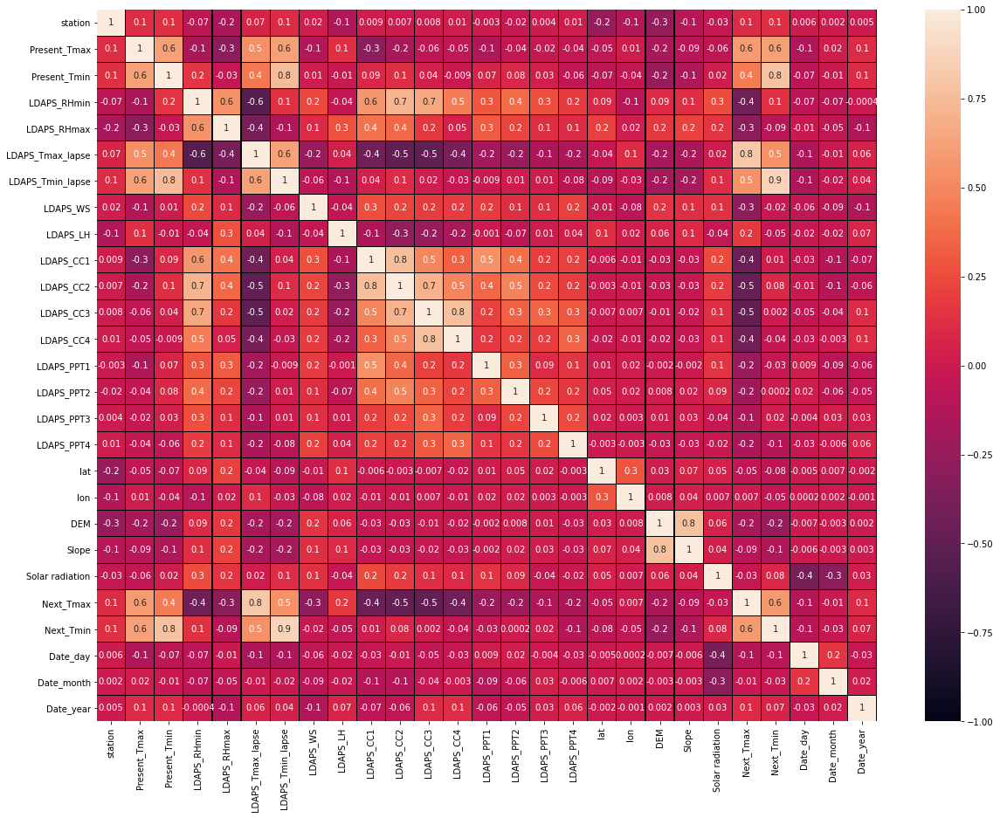

In [81]:
# Visualizing the correlation matrix by plotting heat map.
plt.figure(figsize=(20,15))
sns.heatmap(new_df.corr(),linewidths=.1,vmin=-1, vmax=1, fmt='.1g',linecolor="black", annot = True, annot_kws={'size':10})
plt.yticks(rotation=0);

This heatmap shows the correlation matrix by visualizing the data. we can observe the relation between feature to feature and feature to label. This heat mapcontains both positive and negative correlation.


## Correlation between Next_Tmax and features


- The label Next_Tmax is highly positively correlated with LDAPS_Tmax_lapse
- The label Next_Tmax is well positively correlated with Present_Tmax , Next_Tmin,LDAPS_Tmin_lapse, Present_Tmin, LDAPS_LH, station, Date_year
- The label is negatively correlated with solar_radiation, lat, DEM, Slope, Date_Day, LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3.
- Other columns are more negatively correlated with the Next_Tmax.
- The columns longitude and Date_month have very less correlation with the label.


## Correlation between Next_Tmin and features


- The label Next_Tmin is highly positively correlated with LDAPS_Tmin_lapse, Present_Tmin, LDAPS_Tmax_lapse, Present_Tmax and Next_Tmax.
- The label Next_Tmax is less positively correlated with LDAPS_RHmin, station, solar radiation, LDAPS_CC2, Date_ year, and LDAPS_PPT3
- Other columns are negatively correlated with the Next_Tmin
- The columns LDAPS_CC1, LDAPS_CC3, LDAPS_PPT2, LDAPS_WS have very less correlation with the label.

From the heat map we can observe that most of the features are highly correlated with each other which leads to a multicollinearity problem. We will check VIF values and then drop the columns containing VIF less than 5 to get rid of multicollinearity issue.

## 1. Prediction for Next_Tmax
### Visualizing the correlation between label Next_Tmax and features using bar plot

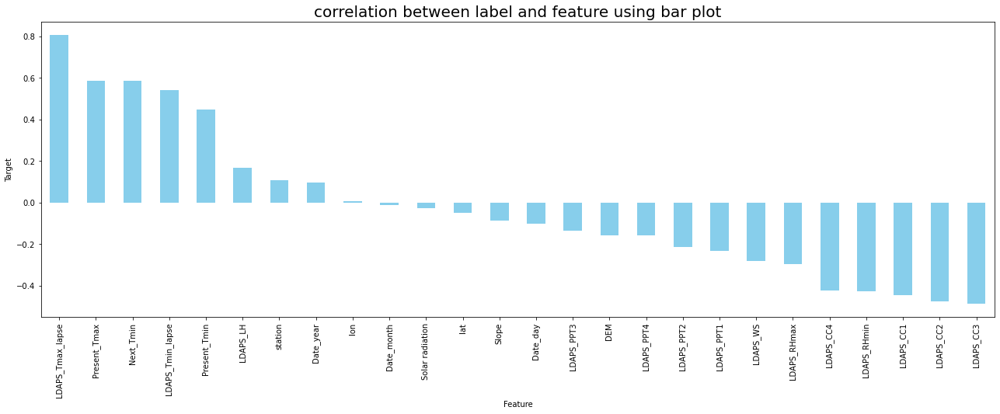

In [82]:
plt.figure(figsize=(22,7))
new_df.corr()['Next_Tmax'].sort_values(ascending=False).drop(['Next_Tmax']).plot(kind='bar',color='skyblue')
plt.xlabel('Feature',fontsize=10)
plt.ylabel('Target',fontsize=10)
plt.title('correlation between label and feature using bar plot',fontsize=20)
plt.show()

The columns longitude and Date_month have very less correlation with the label. We can drop these columns if necessary.

## 2. Prediction for Next_Tmin


### Visualizing the correlation between label Next_Tmin and features using bar plot

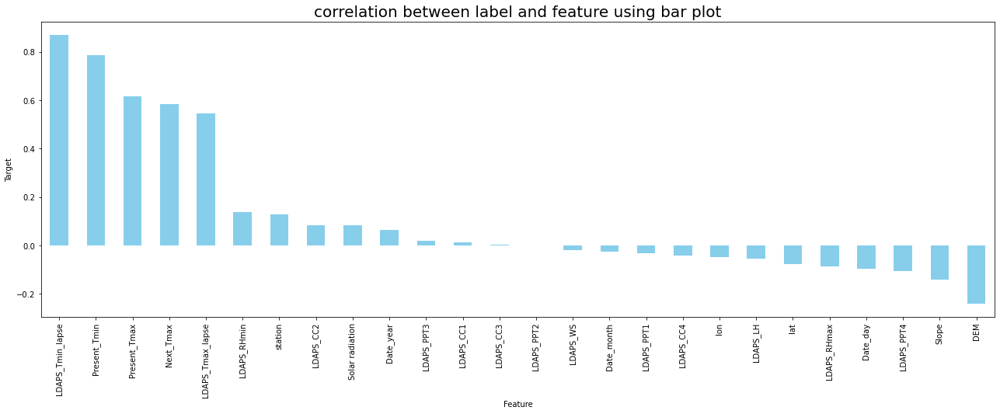

In [174]:
plt.figure(figsize=(22,7))
new_df.corr()['Next_Tmin'].sort_values(ascending=False).drop(['Next_Tmin']).plot(kind='bar',color='skyblue')
plt.xlabel('Feature',fontsize=10)
plt.ylabel('Target',fontsize=10)
plt.title('correlation between label and feature using bar plot',fontsize=20)
plt.show()

The columns LDAPS_CC1, LDAPS_CC3, LDAPS_PPT2, LDAPS_WS have very less correlation with the label. We can drop these columns if necessary.

# Checking for skewness

In [83]:
# Checking the skewness
new_df.skew()

station             0.002230
Present_Tmax       -0.274967
Present_Tmin       -0.232563
LDAPS_RHmin         0.306629
LDAPS_RHmax        -0.691582
LDAPS_Tmax_lapse   -0.107855
LDAPS_Tmin_lapse   -0.400578
LDAPS_WS            1.095290
LDAPS_LH            0.571067
LDAPS_CC1           0.593987
LDAPS_CC2           0.501474
LDAPS_CC3           0.709766
LDAPS_CC4           0.721344
LDAPS_PPT1          3.753955
LDAPS_PPT2          4.874124
LDAPS_PPT3          5.517553
LDAPS_PPT4          5.974954
lat                 0.106291
lon                -0.276193
DEM                 1.761452
Slope               1.592353
Solar radiation    -0.503706
Next_Tmax          -0.270276
Next_Tmin          -0.293914
Date_day            0.252759
Date_month         -0.684769
Date_year           0.008778
dtype: float64

# Observations
The following columns contains skewness greater than +0.5 and -0.5.

- LDAPS_RHmax
- LDAPS_WS
- LDAPS_LH
- LDAPS_CC1
- LDAPS_CC3
- LDAPS_CC4
- LDAPS_PPT1
- LDAPS_PPT2
- LDAPS_PPT3
- LDAPS_PPT4
- DEM
- Slope
- Date_month

We will remove the skewness using PowerTransformer method.

# Removing skewness

# Feature Scaling using PowerTransformer

In [85]:
from sklearn.preprocessing import PowerTransformer

transformer = PowerTransformer()

In [86]:
# Separating the features and label variables into x and y
y_max = new_df['Next_Tmax']
y_min = new_df['Next_Tmin']
X_max = new_df.drop('Next_Tmax',axis=1 )
X_min = new_df.drop('Next_Tmin',axis=1 )
x = new_df.drop(['Next_Tmax','Next_Tmin'],axis=1 )
y = new_df[['Next_Tmax','Next_Tmin']]

In [87]:
#Transforming the labels using power transformer
features =  transformer.fit_transform(x)
features_1_1 = transformer.fit_transform(X_max)
features_2_1 = transformer.fit_transform(X_min)

In [88]:
#Creating a dataframe for the transformed columns
x_transformed = pd.DataFrame(features, columns = x.columns)
x_transformed_maxT = pd.DataFrame(features_1_1, columns = X_max.columns)
x_transformed_minT = pd.DataFrame(features_2_1, columns = X_min.columns)

In [89]:
# Importing necessary library
from  sklearn.decomposition import PCA

In [90]:
# Transforming the model using PCA
pca = PCA()
pca.fit(x_transformed,y_max)

PCA()

In [128]:
# Checking the diamension of X_max
X_max.shape

(6907, 26)

X_max has 6907 rows and 26 columns

In [129]:
# Checking the diamension of X_min
X_min.shape

(6907, 26)

X_min also has 6907 rows and 26 columns

<BarContainer object of 25 artists>

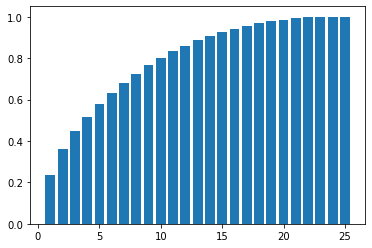

In [115]:
#Plotting bar plot for PCA transformed variables for y_max
plt.bar(range(1,26),np.cumsum(pca.explained_variance_ratio_))

<BarContainer object of 25 artists>

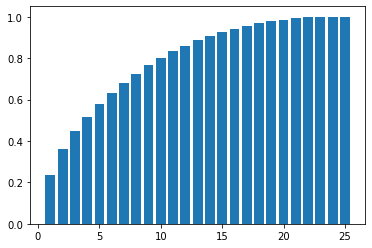

In [117]:
pca = PCA()
pca.fit(x_transformed,y_min)

#Plotting bar plot for PCA transformed variables for y_min
plt.bar(range(1,26),np.cumsum(pca.explained_variance_ratio_))

AS we can see 21 elements are giving more than 90% information about the Target Variable.

In [95]:
x_transformed_minT.skew()

station            -0.202037
Present_Tmax       -0.032015
Present_Tmin       -0.021976
LDAPS_RHmin        -0.013861
LDAPS_RHmax        -0.100108
LDAPS_Tmax_lapse   -0.011193
LDAPS_Tmin_lapse   -0.025801
LDAPS_WS            0.006054
LDAPS_LH           -0.028792
LDAPS_CC1           0.062695
LDAPS_CC2           0.047328
LDAPS_CC3           0.092375
LDAPS_CC4           0.141116
LDAPS_PPT1          1.625143
LDAPS_PPT2          1.828579
LDAPS_PPT3          2.005782
LDAPS_PPT4          2.284866
lat                 0.000000
lon                -0.190080
DEM                 0.038646
Slope               0.233614
Solar radiation    -0.166195
Next_Tmax          -0.035503
Date_day           -0.035338
Date_month          0.039871
Date_year           0.000000
dtype: float64

## DATA MODELLING
- Modelling 2 Different Models for MAxT temp and minT temp
- Using MinT as a feature to predict MaxT and 
- Using MaxT as a feature to predict MinT, since MinT and MaxT (Target Variables) are dpeendant on Each Other
- Random State function and model prediction is common and unified for any model and any dataset and Target.

In [105]:
# Importing necessary libraries
from sklearn.multioutput import MultiOutputRegressor
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV,cross_val_score
from sklearn.linear_model import LinearRegression, Ridge , Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR, LinearSVR
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error

In [106]:
# Defining a function to find best random state for any model

def random_state_func(model,x,y):
    
    randomstate = 0
    max_score = 0
    
    for i in range(1,50):
        x_train,x_test,y_train,y_test = train_test_split(x, y,test_size=.30,random_state=i)
        model.fit(x_train,y_train)
        pred = model.predict(x_test)
        score = r2_score(y_test,pred)    
        if(score>max_score):
            max_score = score
            randomstate  = i
            
    return(randomstate,max_score)


In [107]:
#Creating empty lists to store the values in them
cv_scores = []
r2_scores = []
rmse = []

In [118]:
# Method to for algorithm prediction for any model.

def model_predict(model,randomstate,x,y):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.33,random_state=randomstate)
    model.fit(x_train,y_train)
    predictions = model.predict(x_test)
    cv_score = np.mean(cross_val_score(model,x,y,cv=10,scoring='r2'))
     
    print('------------',model,'--------------')
    print(' R2 Score              : ', r2_score(y_test,predictions))
    print('Cross Validation Score : ',cv_score)
    print('Root Mean Squared Error :',np.sqrt(mean_squared_error(y_test,predictions)))
    print('Absolute Mean Square   :', mean_absolute_error(y_test,predictions))
    
    
  
    r2_scores.append(r2_score(y_test,predictions))
    cv_scores.append(cv_score)
    rmse.append(np.sqrt(mean_squared_error(y_test,predictions)))
    
    
    plt.figure(figsize=(6,5))
    
    sns.regplot(y_test,predictions,color='indigo',)
    plt.xlabel('Y_True')
    plt.ylabel('Y_predicted')
    plt.show()    

## LINEAR REGRESSION

In [119]:
rs,score = random_state_func(LinearRegression(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(LinearRegression(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

Random State :  17  with r2 score : 0.784098516713036
Random State :  46  with r2 score : 0.8473091217747126


------------ LinearRegression() --------------
 R2 Score              :  0.7849792777535443
Cross Validation Score :  0.7730545367825324
Root Mean Squared Error : 1.3527049537196363
Absolute Mean Square   : 1.0198495159674066


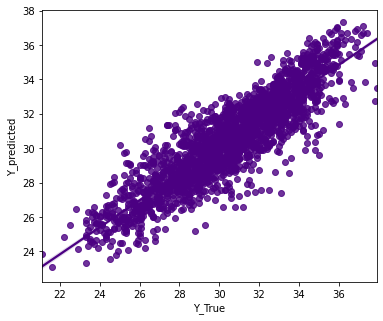

In [120]:
model_predict(LinearRegression(),rs,X_max,y_max)

------------ LinearRegression() --------------
 R2 Score              :  0.8453433827259944
Cross Validation Score :  0.8360695338624005
Root Mean Squared Error : 0.946578063563356
Absolute Mean Square   : 0.7521230033542904


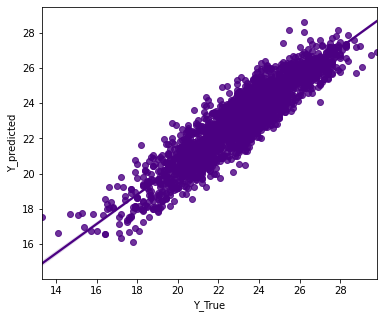

In [121]:
model_predict(LinearRegression(),rs1,X_min,y_min)

## RIDGE

Random State :  17  with r2 score : 0.7841388349651883
Random State :  46  with r2 score : 0.8472858501271114


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ Ridge() --------------
 R2 Score              :  0.7850383200272405
Cross Validation Score :  0.7730657275492253
Root Mean Squared Error : 1.3525192221802387
Absolute Mean Square   : 1.0196806669148986


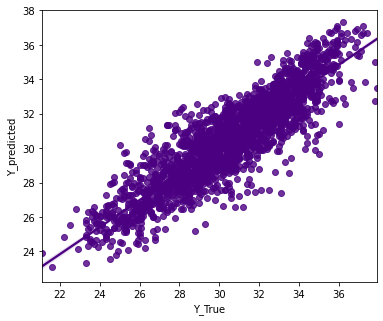


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ Ridge() --------------
 R2 Score              :  0.8453338267927775
Cross Validation Score :  0.8360764167910817
Root Mean Squared Error : 0.9466073067253973
Absolute Mean Square   : 0.7520795583091902


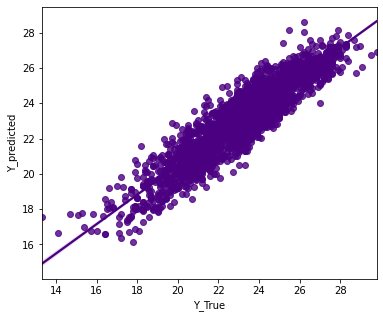

In [123]:
rs,score = random_state_func(Ridge(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(Ridge(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(Ridge(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(Ridge(),rs1,X_min,y_min)

## LASSO

Random State :  8  with r2 score : 0.7120783153567521
Random State :  26  with r2 score : 0.7890411690071292


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ Lasso() --------------
 R2 Score              :  0.7111505803485212
Cross Validation Score :  0.6970069232851659
Root Mean Squared Error : 1.5728691273442486
Absolute Mean Square   : 1.2129174465059096


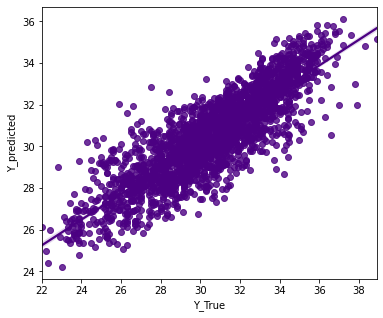


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ Lasso() --------------
 R2 Score              :  0.7873891454636659
Cross Validation Score :  0.7779182600217587
Root Mean Squared Error : 1.1022990774468406
Absolute Mean Square   : 0.8764065822823546


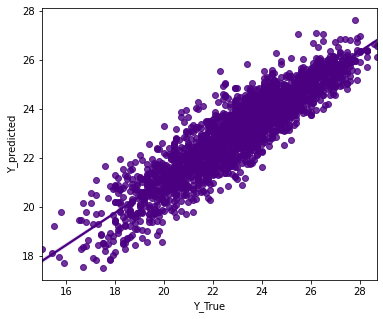

In [124]:
rs,score = random_state_func(Lasso(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(Lasso(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(Lasso(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(Lasso(),rs1,X_min,y_min)

## SVR

Random State :  46  with r2 score : 0.04275169638880083
Random State :  16  with r2 score : 0.10433712428735631


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ SVR() --------------
 R2 Score              :  0.04076111858439535
Cross Validation Score :  0.04593350495611378
Root Mean Squared Error : 2.843196219083933
Absolute Mean Square   : 2.304085609691598


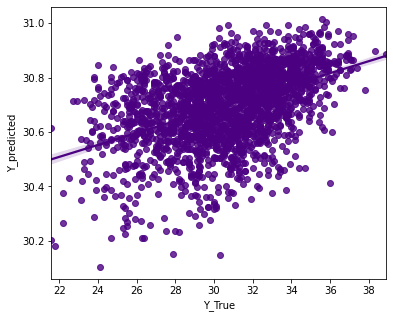


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ SVR() --------------
 R2 Score              :  0.09905026742206269
Cross Validation Score :  0.11425800815759035
Root Mean Squared Error : 2.211254631055939
Absolute Mean Square   : 1.7605424125826314


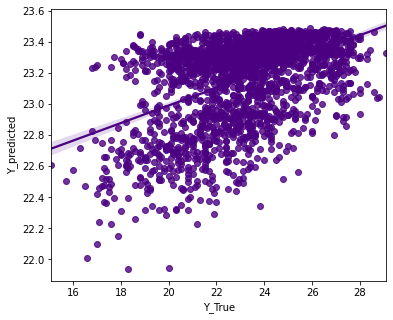

In [125]:
rs,score = random_state_func(SVR(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(SVR(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(SVR(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(SVR(),rs1,X_min,y_min)

AS you can clearly see, the cv score and r2 score difference is very high, suggesting that SVR is prone for overfitting.

## DECISION TREE

Random State :  15  with r2 score : 0.7946746187072004
Random State :  49  with r2 score : 0.814463344401745


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ DecisionTreeRegressor() --------------
 R2 Score              :  0.785737073628431
Cross Validation Score :  0.7860480707484223
Root Mean Squared Error : 1.3826497185551143
Absolute Mean Square   : 1.0026423948220065


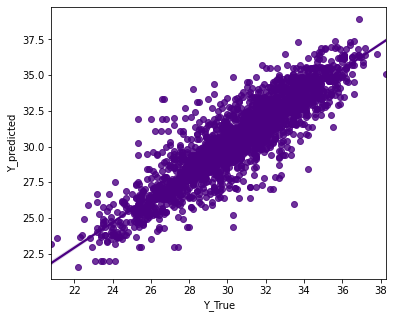


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ DecisionTreeRegressor() --------------
 R2 Score              :  0.7964783303307196
Cross Validation Score :  0.7818241180524381
Root Mean Squared Error : 1.0806964019674161
Absolute Mean Square   : 0.8060526315789474


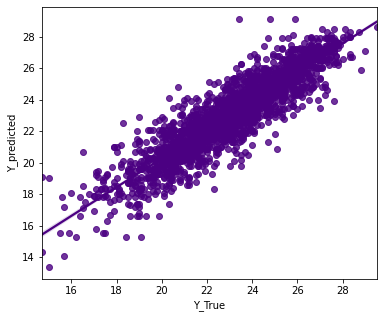

In [126]:
rs,score = random_state_func(DecisionTreeRegressor(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(DecisionTreeRegressor(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(DecisionTreeRegressor(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(DecisionTreeRegressor(),rs1,X_min,y_min)

## ENSEMBLE TECHNIQUES

## RAMDOM FOREST

Random State :  29  with r2 score : 0.9052015752495989
Random State :  35  with r2 score : 0.9072175473459426


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ RandomForestRegressor() --------------
 R2 Score              :  0.9037188921408345
Cross Validation Score :  0.9064595296080107
Root Mean Squared Error : 0.9074572653641071
Absolute Mean Square   : 0.6773825086583775


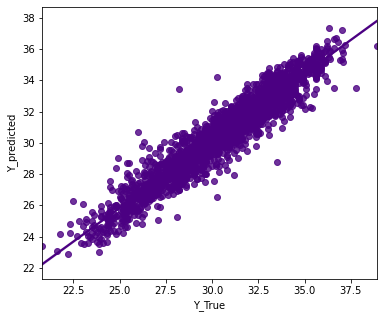


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ RandomForestRegressor() --------------
 R2 Score              :  0.9059061503381656
Cross Validation Score :  0.9065509974659823
Root Mean Squared Error : 0.7468383293648116
Absolute Mean Square   : 0.5704251611309831


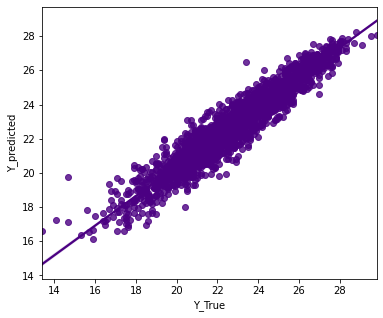

In [130]:
rs,score = random_state_func(RandomForestRegressor(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(RandomForestRegressor(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(RandomForestRegressor(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(RandomForestRegressor(),rs1,X_min,y_min)

# XGBRegressor

Random State :  15  with r2 score : 0.9238542017889971
Random State :  35  with r2 score : 0.934923956932414


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=4,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None) --------------
 R2 Score              :  0.9158609186768571
Cross Validation Score :  0.9223752708073878
Root Mean Squared Error : 0.8664380902161258
Absolute Mean Squar

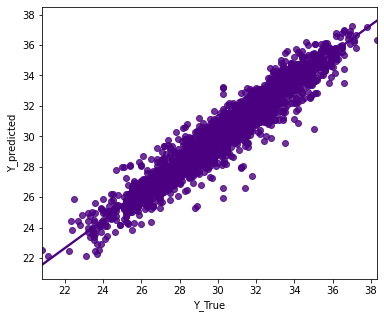


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=4,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None) --------------
 R2 Score              :  0.9282969621503595
Cross Validation Score :  0.9337289157999349
Root Mean Squared Error : 0.6519507032318019
Absolute Mean Square   : 0.4942542921145013


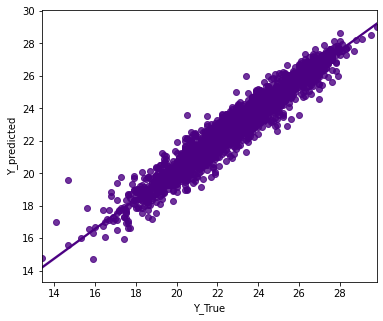

In [131]:
rs,score = random_state_func(XGBRegressor(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(XGBRegressor(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(XGBRegressor(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(XGBRegressor(),rs1,X_min,y_min)

## LGBMRegressor

Random State :  35  with r2 score : 0.9263712069149754
Random State :  35  with r2 score : 0.9363412371409402


************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************


------------ LGBMRegressor() --------------
 R2 Score              :  0.9242842039259117
Cross Validation Score :  0.9234447144252551
Root Mean Squared Error : 0.8161531970751864
Absolute Mean Square   : 0.6198259663226366


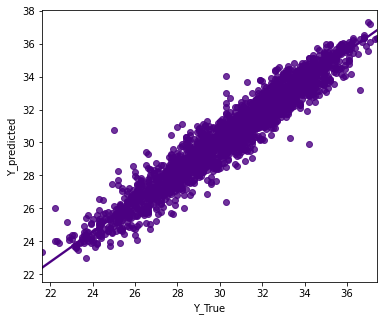


************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************

------------ LGBMRegressor() --------------
 R2 Score              :  0.9333175304120825
Cross Validation Score :  0.9346758179971278
Root Mean Squared Error : 0.6287120989088073
Absolute Mean Square   : 0.48224983485336


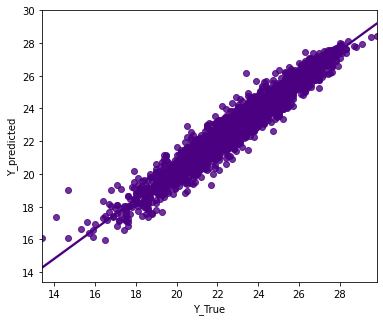

In [132]:
rs,score = random_state_func(LGBMRegressor(),X_max,y_max)
print('Random State : ', rs , ' with r2 score :',score)
rs1,score1 = random_state_func(LGBMRegressor(),X_min,y_min)
print('Random State : ', rs1 , ' with r2 score :',score1)

print('\n\n************** PREDICTIONS for NEXT DAY MAX TEMPRATURE ********************\n\n')

model_predict(LGBMRegressor(),rs,X_max,y_max)
print('\n************** PREDICTIONS for NEXT DAY MIN TEMPRATURE ********************\n')
model_predict(LGBMRegressor(),rs1,X_min,y_min)

In [134]:
error = []
for i in range(0,16):
    error.append(np.abs(r2_scores[i] - cv_scores[i]))

In [135]:
r2_max = []
r2_min = []
rmse_max = []
rmse_min = []
err_max = []
cv_max = []
cv_min = []
err_min = []
for i in range(0,16):
    if(i%2==0):
        r2_max.append(r2_scores[i])
        rmse_max.append(rmse[i])
        err_max.append(error[i])
        cv_max.append(cv_scores[i])
    else:
        r2_min.append(r2_scores[i])
        rmse_min.append(rmse[i])
        err_min.append(error[i])
        cv_min.append(cv_scores[i])

In [136]:
table_dict_max = {
    'R2 SCORE: ':r2_max,
    
    'CV SCORE': cv_max,
    'RMSE ': rmse_max,
    'Bias/Error': err_max
}
table_dict_min = {
    'R2 SCORE: ':r2_min,
    
    'CV SCORE': cv_min,
    'RMSE ': rmse_min,
    'Bias/Error': err_min
}

In [137]:
score_max = pd.DataFrame(table_dict_max,index=['LR_MAX_T','Rd_MAX_T','Lasso_MAX_T','SVR_MAX_T','DTC_MAX_T',
                                             'RF_MAX_T','XGB_MAX_T','LGB_MAX_T'  ])

score_min = pd.DataFrame(table_dict_min,index=['LR_MIN_T','Rd_MIN_T','Lasso_MIN_T','SVR_MIN_T','DTC_MIN_T',
                                             'RF_MIN_T','XGB_MIN_T','LGB_MIN_T'  ])

In [138]:
score_max

,R2 SCORE:,CV SCORE,RMSE,Bias/Error
LR_MAX_T,0.784979,0.773055,1.352705,0.011925
Rd_MAX_T,0.784979,0.773055,1.352705,0.011925
Lasso_MAX_T,0.785038,0.773066,1.352519,0.011973
SVR_MAX_T,0.785038,0.773066,1.352519,0.011973
DTC_MAX_T,0.711151,0.697007,1.572869,0.014144
RF_MAX_T,0.040761,0.045934,2.843196,0.005172
XGB_MAX_T,0.785737,0.786048,1.382650,0.000311
LGB_MAX_T,0.903719,0.906460,0.907457,0.002741


#### NEXT_TMAX has highest r2 score of LGB_MAX_T  Model. But error is higher compared to XGB_MAX_T	model.

##### we choose least biased model i.e XGB_MAX_T	(XGB model)

`Choosen Model:` XGB model , least overfitted model, other models are highly overfitting.

In [139]:
score_min

,R2 SCORE:,CV SCORE,RMSE,Bias/Error
LR_MIN_T,0.784979,0.773055,1.352705,1.192474e-02
Rd_MIN_T,0.845343,0.836070,0.946578,9.273849e-03
Lasso_MIN_T,1.000000,1.000000,0.000210,3.063099e-09
SVR_MIN_T,0.845334,0.836076,0.946607,9.257410e-03
DTC_MIN_T,0.787389,0.777918,1.102299,9.470885e-03
RF_MIN_T,0.099050,0.114258,2.211255,1.520774e-02
XGB_MIN_T,0.796478,0.781824,1.080696,1.465421e-02
LGB_MIN_T,0.905906,0.906551,0.746838,6.448471e-04


### NEXT_TMIN has highest r2 score of LGB_MIN_T Model. But error is higher compared to XGB_MIN_T model.

####  we choose least biased model i.e XGB_MIN_T (XGB model)

`Choosen Model:` XGB model , least overfitted model, other models are highly overfitting.

# HYPER PARAMETER TUNING 

# 1. NEXT DAY MAX TEMPRATURE (MaxT)

In [150]:
# Importing necessary libraries
from xgboost import XGBRegressor as xgb
from sklearn.model_selection import GridSearchCV

#Assigning a variable to XGB regressor
XGB=xgb()

# Getting the best parameters for XGB Regressor

parameters = {'n_estimators' : [50,100,150,200],
              'learning_rate':np.arange(0.05,0.5,0.05),
              'gamma' : np.arange(0,0.5,0.1),
              'max_depth' : [4, 6, 8,10]}

In [151]:
#Assigning a variable for the model
GCV = GridSearchCV(xgb(), parameters, cv=5)

In [152]:
#Applying it to the x and y
GCV.fit(x_transformed_maxT,y_max)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    enable_categorical=False, gamma=None,
                                    gpu_id=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n...
                                    num_parallel_tree=None, predictor=None,
                                    random_state=None, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                                 

In [153]:
GCV.best_params_

{'gamma': 0.1,
 'learning_rate': 0.15000000000000002,
 'max_depth': 6,
 'n_estimators': 200}

In [154]:
model = xgb(gamma=0.1, learning_rate=0.15000000000000002, max_depth=6, n_estimators=200)
x_train,x_test,y_train,y_test = train_test_split(x_transformed_maxT,y_max,test_size=.33)
model.fit(x_train,y_train)
predictions = model.predict(x_test)
cv_score = np.mean(cross_val_score(model,x_transformed_maxT,y_max,cv=10,scoring='r2'))

print('\n------------',model,'--------------')
print('\n R2 Score              : ', r2_score(y_test,predictions))
print('\nCross Validation Score : ',cv_score)
print('\nRoot Mean Squared Error :',np.sqrt(mean_squared_error(y_test,predictions)))
print('\nAbsolute Mean Square   :', mean_absolute_error(y_test,predictions))
err = np.abs(r2_score(y_test,predictions) - cv_score)
print('\nError (validation score - training score)    :'    , err)


------------ XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0.1, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.15000000000000002,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=200, n_jobs=4,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None) --------------

 R2 Score              :  0.9273629836848477

Cross Validation Score :  0.9330119820263645

Root Mean Squared Error : 0.795106701431375

Absolute Mean Square   : 0.6034218892247079

Error (validation score - training score)    : 0.0056489983415167755


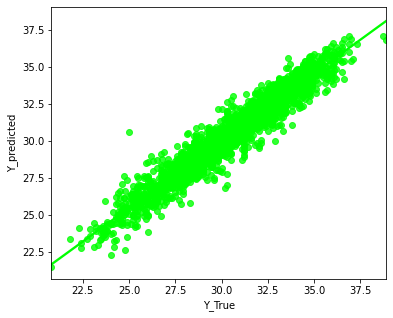

In [157]:
plt.figure(figsize=(6,5))
    
sns.regplot(y_test,predictions,color='lime',)
plt.xlabel('Y_True')
plt.ylabel('Y_predicted')
plt.show()

Text(0.5, 0, 'Error Variance Distribution')

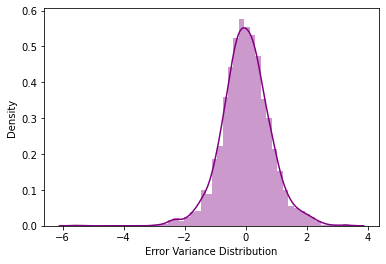

In [158]:
# distribution of Error (difference btw y_true and y_predicted should follow gaussian structure)
plt.figure()
sns.distplot(y_test - predictions,color='purple')
plt.xlabel('Error Variance Distribution')

#### Error variance follow standard normalized structure, suggesting that the model is not overfitting.

In [161]:
# SAVING TMIN
import joblib

joblib.dump(model, 'Temperature_Forecast_Next_Tmax.pkl')

['Temperature_Forecast_Next_Tmax.pkl']

We have saved the model using jiblib library.

## Predicting the saved model

In [162]:
# Loading the saved model
Model=joblib.load("Temperature_Forecast_Next_Tmax.pkl")

#Prediction
prediction_Tmax = Model.predict(x_test)
prediction_Tmax

array([33.60112 , 35.454678, 31.782642, ..., 31.234293, 31.511366,
       29.301914], dtype=float32)

Here we have loaded our saved model of predictioon for Next_Tmax and got the predicted next day maximum temperature values which are displayes above.

In [163]:
#Assigning a variable and creating a dataframe of the Actual and predicted output values
Data=pd.DataFrame([Model.predict(x_test)[:],y_test[:]],index=["Predicted","Actual"])
Data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

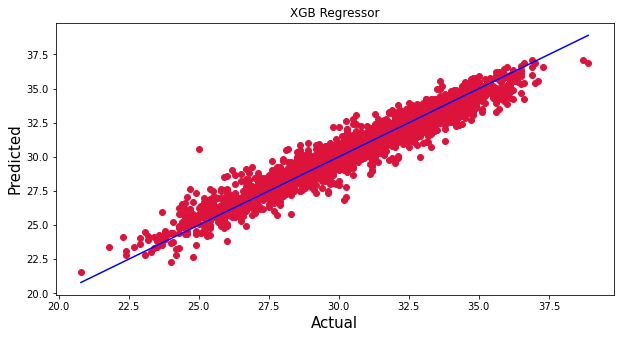

In [164]:
# Plotting a graph for the Actual and predicted outputs
plt.figure(figsize=(10,5))
plt.scatter(y_test, prediction_Tmax, c='crimson')
p1 = max(max(prediction_Tmax), max(y_test))
p2 = min(min(prediction_Tmax), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual', fontsize=15)
plt.ylabel('Predicted', fontsize=15)
plt.title("XGB Regressor")
plt.show()

We have created a DataFrame of Actual and Predicted temperature values . Here Actual Next_Tmax and predicted Next_Tmax temperature values look similar, except for few exceptions.

# 2. NEXT DAY MIN TEMPRATURE (MinT)

In [165]:
model1 = xgb(gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=200)
x_train,x_test,y_train,y_test = train_test_split(x_transformed_minT,y_min,test_size=.33,random_state=43)
model1.fit(x_train,y_train)
predictions = model1.predict(x_test)
cv_score = np.mean(cross_val_score(model1,x_transformed_minT,y_min,cv=10,scoring='r2'))

print('\n------------',model,'--------------')
print('\n R2 Score              : ', r2_score(y_test,predictions))
print('\nCross Validation Score : ',cv_score)
print('\nRoot Mean Squared Error :',np.sqrt(mean_squared_error(y_test,predictions)))
print('\nAbsolute Mean Square   :', mean_absolute_error(y_test,predictions))
err = np.abs(r2_score(y_test,predictions) - cv_score)
print('\nError (validation score - training score)    :'    , err)


------------ XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0.1, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.15000000000000002,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=200, n_jobs=4,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None) --------------

 R2 Score              :  0.9334554981405603

Cross Validation Score :  0.941872443637098

Root Mean Squared Error : 0.6043659600743709

Absolute Mean Square   : 0.46161287340079604

Error (validation score - training score)    : 0.008416945496537709


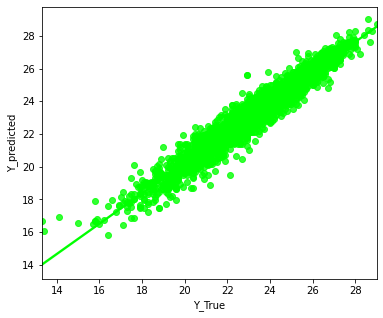

In [166]:
plt.figure(figsize=(6,5))
    
sns.regplot(y_test,predictions,color='lime',)
plt.xlabel('Y_True')
plt.ylabel('Y_predicted')
plt.show()    

Text(0.5, 0, 'Error Variance Distribution')

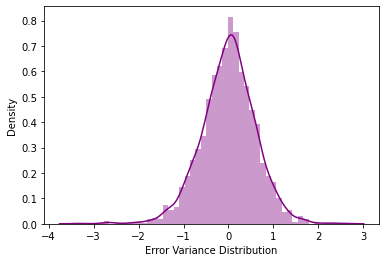

In [167]:
# distribution of Error (difference btw y_true and y_predicted should follow gaussian structure)
plt.figure()
sns.distplot(y_test - predictions,color='purple')
plt.xlabel('Error Variance Distribution')

#### Error variance follow standard normalized structure,suggesting that the model is not overfitting.

In [169]:
# SAVING TMAX MODEL

import joblib

joblib.dump(model1, 'Temperature_Forecast_Next_Tmin.pkl')

['Temperature_Forecast_Next_Tmin.pkl']

We have saved the model using joblib library.

# Predicting the saved model

In [171]:
# Loading the saved model
Model1=joblib.load("Temperature_Forecast_Next_Tmin.pkl")

#Prediction
prediction_Tmin = Model1.predict(x_test)
prediction_Tmin

array([21.95491 , 26.028063, 20.117943, ..., 20.346819, 21.645733,
       25.360998], dtype=float32)

Here we have loaded our saved model of predictioon for Next_Tmax and got the predicted next day maximum temperature values which are displayes above.

In [172]:
#Assigning a variable and creating a dataframe of the Actual and predicted output values
Data1=pd.DataFrame([Model1.predict(x_test)[:],y_test[:]],index=["Predicted","Actual"])
Data1

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

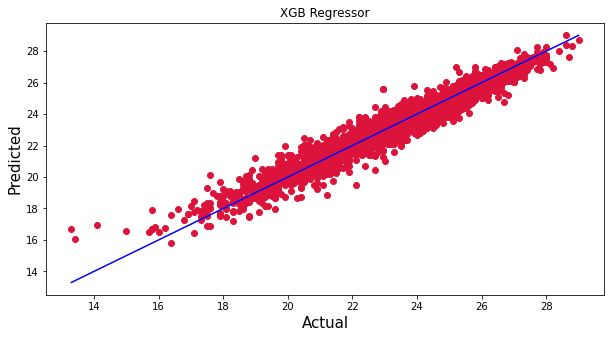

In [173]:
# Plotting a graph for the Actual and predicted outputsplt.figure(figsize=(10,5))
plt.scatter(y_test, prediction_Tmin, c='crimson')
p1 = max(max(prediction_Tmin), max(y_test))
p2 = min(min(prediction_Tmin), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual', fontsize=15)
plt.ylabel('Predicted', fontsize=15)
plt.title("XGB Regressor")
plt.show()

We have created a DataFrame of Actual and Predicted temperature values . Here Actual Next_Tmin and predicted Next_Tmin temperature values look similar, except for few exceptions.

## Conclusion:
- The final R2 score for the prediction of Next_Tmax using xgb Regression algorithm is = 93.30%.
- The final R2 score for the prediction of Next_Tmin using xgb Regression algorithm is = 93.34%.